# scVI data integration of Myeloid compartment

In [5]:
import sys 
import os
from datetime import datetime

import pandas as pd
import numpy as np
import scanpy as sc
import anndata as ad
import scvi
import hdf5plugin

import matplotlib.pyplot as plt
import seaborn as sns

# Add repo path to sys path (allows to access scripts and metadata from repo)
repo_path = os.path.split(os.getcwd())[0]
sys.path.insert(1, repo_path) 
sys.path.insert(2, '/lustre/scratch126/cellgen/team205/lm25/thymus_projects/thymus_ageing_atlas/General_analysis/scripts')

from scvi_wrapper2 import run_scvi
import torch
torch.cuda.is_available()

%reload_ext autoreload

False

In [6]:
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all" # to show output from all the lines in a cells
pd.set_option('display.max_column',None) # display all the columns in pandas
pd.options.display.max_rows = 100
import matplotlib
from matplotlib import rcParams
rcParams['pdf.fonttype'] = 42
sc.settings.set_figure_params(dpi = 150, color_map = 'RdPu', dpi_save = 150, vector_friendly = True, format = 'pdf')

In [7]:
# Define plot and path dirs
plot_path = os.path.join(repo_path, 'plots')
data_path = os.path.join(repo_path, 'data')
model_path = os.path.join(repo_path, 'models')
general_data_path = '/lustre/scratch126/cellgen/team205/lm25/thymus_projects/thymus_ageing_atlas/General_analysis/data'

In [8]:
myeloid_mrkrs_dict = {
    'Early progenitor': ['CD34', 'SPINK2'], # 'MLLT3'
    'Myeloid progenitor': ['PRSS57', 'PRTN3', 'AZU1'],
    'Neutrophil lineage': ['ELANE', 'DEFA4', 'LCN2', 'ORM1'],
    'Monocyte lineage': ['CD52', 'S100A8', 'MS4A6A', 'CD14', 'CXCR4', 'CCR2', 'IL1B'],
    'RBC': ['GYPA', 'GYPB','HBA1', 'HBA2'],
    'panMacrophage':['CD68', 'CD163'],
    'LYVE1 Macrophage': ['LYVE1', 'EGFL7', 'LILRB5'], #'CX3CR1' 
    'SPIC Macrophage': ['SPIC', 'TIMD4'],
    'APOC2 Macrophage': ['APOC2', 'MMP9', 'GPNMB'],
    'cDC1': ['CLEC9A', 'XCR1'],
    'cDC2': ['CLEC10A', 'CD1C'],
    'aDC': ['LAMP3', 'CCR7', 'CD80', 'HLA-DRA', 'CD86'],
    'aDC1':['IDO1', 'CST7', 'IL12B', 'KCNN1'], #'TNFRSF11A', 'ST7',
    'aDC2':['TNFRSF11B', 'CCL17','LYPD3', 'CLEC4G'],#'NEK6', 'CCL22',
    'aDC3':['SELENOM', 'MT2A', 'EYA4', 'SYNPO2'],
    'AIRE DCs': ['TNFRSF11B', 'AIRE'],
    'pDC' :['LILRA4', 'CLEC4C'],
    'Prolif':['MKI67', 'TOP2A']}

myeloid_mrkrs = []
[myeloid_mrkrs.extend(myeloid_mrkrs_dict[key]) for key in myeloid_mrkrs_dict.keys()]

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

## Load data

In [5]:
adata = ad.read_h5ad(f'{data_path}/objects/thyAgeing_scvi_v2_2024-11-05_myeloidSplit_v2_2layers_300epochs_2025-01-16.zarr')

In [6]:
adata_obs = pd.read_csv(f'{data_path}/objects/thyAgeing_Myeloid_v2_2layers_300epochs_2025-01-16_anno1.csv', index_col = 0)

In [7]:
adata.obs['Myeloid_anno'] = adata_obs.reindex(adata.obs_names)['Myeloid_anno'].copy()

In [8]:
doublets = [i for i in adata.obs['Myeloid_anno'].unique().tolist() if 'doublet' in i]
adata_dbrm = adata[~adata.obs['Myeloid_anno'].isin(doublets),]

In [9]:
adata.shape
adata_dbrm.shape

(19821, 35530)

(14718, 35530)

In [10]:
adata = adata_dbrm.copy()

## Data integration

### remove samples having fewer than 3 cells 

In [11]:
adata.obs['sample'].value_counts().loc[(adata.obs['sample'].value_counts()<3)].index.tolist()

['THY_81',
 'A67-THY-0-SC-FACS-1_5GEX',
 'THY_57',
 'sample4',
 'sample8',
 'sample10']

In [12]:
samples2remove = adata.obs['sample'].value_counts().loc[(adata.obs['sample'].value_counts()<3)].index.tolist()

adata_temp = adata.copy()
adata = adata[~adata.obs['sample'].isin(samples2remove),:].copy()
adata_temp.shape
adata.shape

(14718, 35530)

(14706, 35530)

del adata_temp
import gc 
gc.collect()

In [13]:
general_mrkrs = ['PTPRC', 'CD3G', 
               'HOXA9', 
               'HES1', #DN
               'RORC', #DP
               'CCR9',
              'PDCD1', #CD8aa
              'CD8A', 'CD8B', 
              'CD4', 'CD40LG', 
              'CRTAM', 'ANXA1', #memory
             'FOXP3', 'DHRS3', 
               'TRDC', #gama-delta 
              'EOMES', 'KLRD1', # NK cells
              'TNFSF11', # ILC
              'CD19', 'VPREB1', # pre-pro B cells
              'IGHD', 'IGHA1', 'IGHG1', 
              'CLEC9A', 'CLEC10A', 
              'LAMP3', 
             'LILRA4','S100A9', 'C1QA', 'TPSB2', 'ITGA2B', 'GYPA', 
              'PDGFRA', 'COLEC11', 'FBN1', 
              'RGS5', 'CDH5', 
               'LYVE1', 'EPCAM', 'PSMB11', 'DLK2', 'KRT14', 
               'CCL19', 'AIRE', 'KRT1', 'POU2F3',
               'MYOD1', 'NEUROG1']

[i for i in general_mrkrs if i not in adata.var_names]

[]

In [14]:
adata.obs['age_months'] = adata.obs['age_months'].astype(float)

adata.obs[['age_group', 'age_months','donor', 'chemistry_simple', 'sort', 'study']]

,age_group,age_months,donor,chemistry_simple,sort,study
names,,,,,,
TA13072046-ATGTGTGTCTCTAAGG,adult,240.0,A67,5GEX,EPCAM+CD205+,Thymus_ageing
TA13072046-GGGTTGCGTGATGTCT,adult,240.0,A67,5GEX,EPCAM+CD205+,Thymus_ageing
TA13072046-TTGTAGGGTACTCTCC,adult,240.0,A67,5GEX,EPCAM+CD205+,Thymus_ageing
TA13072046-TTAGTTCTCTGTCTAT,adult,240.0,A67,5GEX,EPCAM+CD205+,Thymus_ageing
TA13072046-CTGTTTAAGTGACTCT,adult,240.0,A67,5GEX,EPCAM+CD205+,Thymus_ageing
...,...,...,...,...,...,...
TEC_96-TTTGGAGTCAGGACGA,infant,48.0,NIHTHY0096,5GEX,EPCAM,Notarangelo2024
TEC_96-ATTTCACCATCCTAAG,infant,48.0,NIHTHY0096,5GEX,EPCAM,Notarangelo2024
TEC_96-GTAATCGGTACCGGAA,infant,48.0,NIHTHY0096,5GEX,EPCAM,Notarangelo2024


Removed excluded genes
Highly variable genes selected in total (14706, 10000)


An NVIDIA GPU may be present on this machine, but a CUDA-enabled jaxlib is not installed. Falling back to cpu.
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
IPU available: False, using: 0 IPUs
HPU available: False, using: 0 HPUs
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/nfs/team205/vk8/mambaforge/envs/scvi-env3/lib/python3.10/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:441: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=5` in the `DataLoader` to improve performance.
/nfs/team205/vk8/mambaforge/envs/scvi-env3/lib/python3.10/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:441: The 'val_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=5` in the `DataLoader` to improve performance.


Epoch 300/300: 100%|█| 300/300 [08:48<00:00,  1.85s/it, v_num=1, train_loss_step=1.98e+3,

`Trainer.fit` stopped: `max_epochs=300` reached.


Epoch 300/300: 100%|█| 300/300 [08:48<00:00,  1.76s/it, v_num=1, train_loss_step=1.98e+3,
scVI model trained
UMAP performed


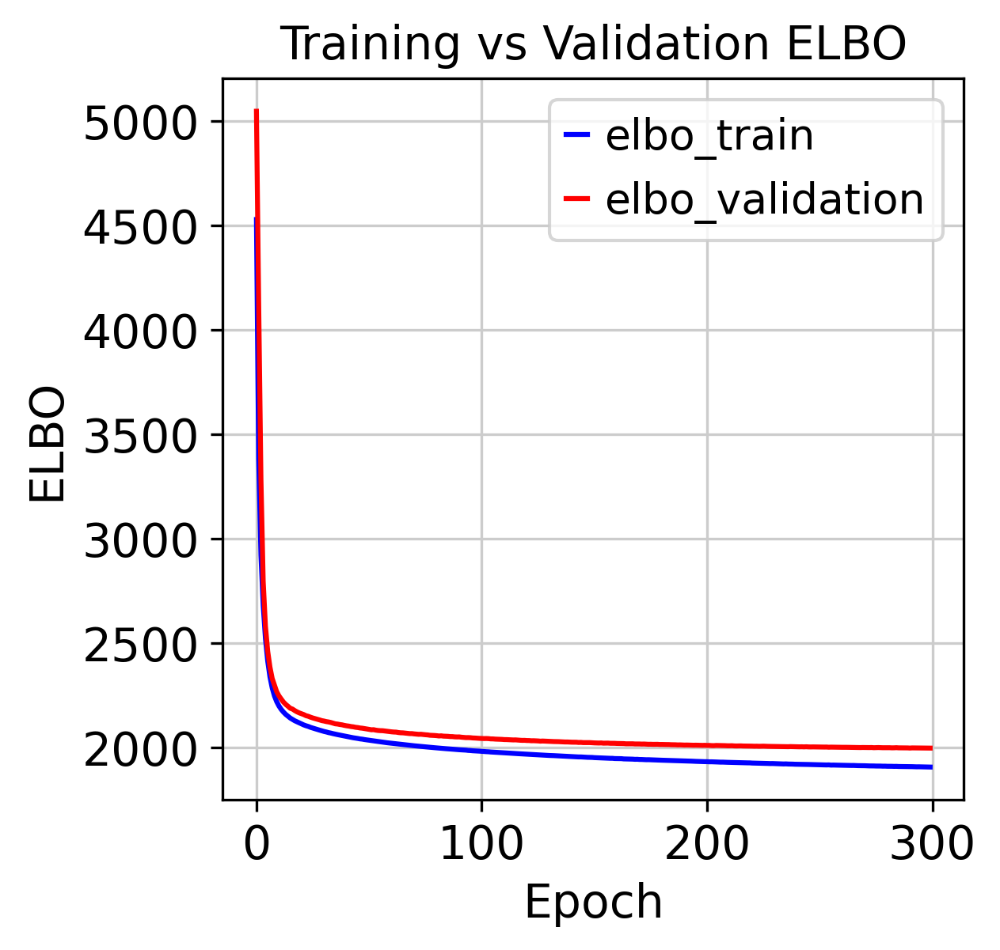

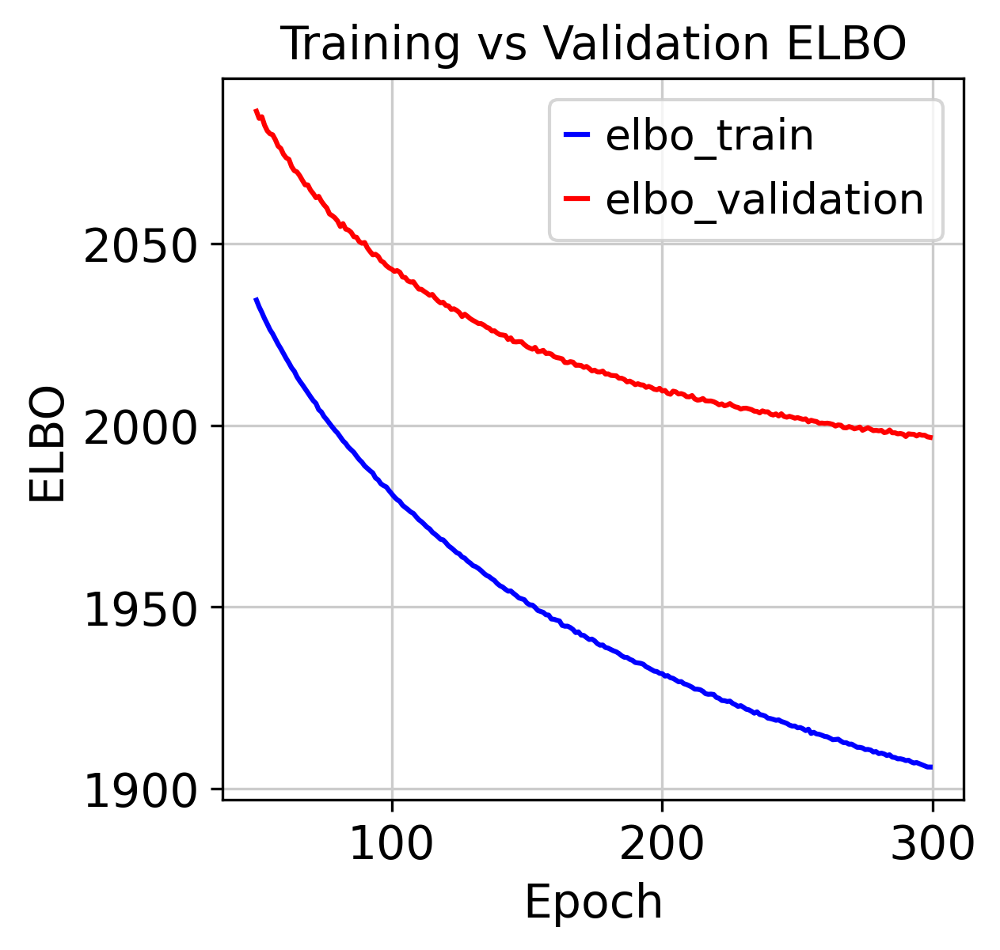

Plotting doublet_metric
Plotting age
Plotting batch_mixing
Plotting cat_covs


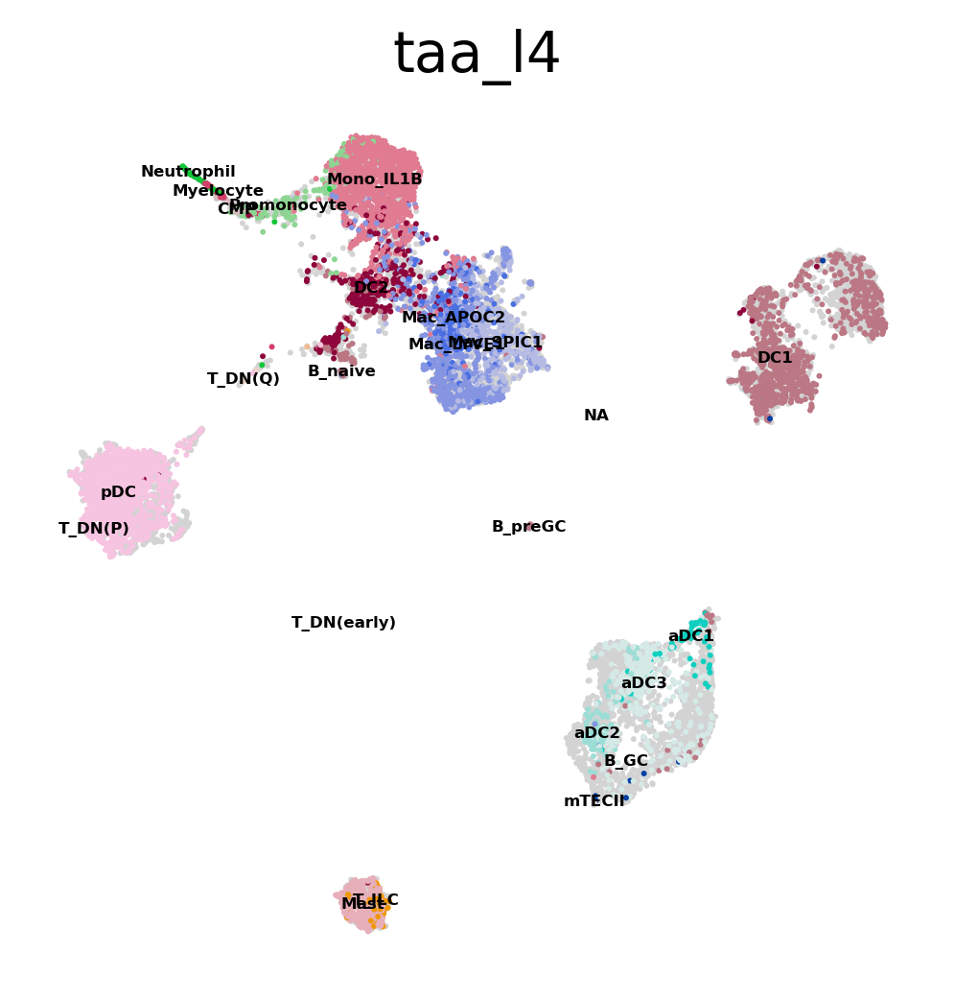

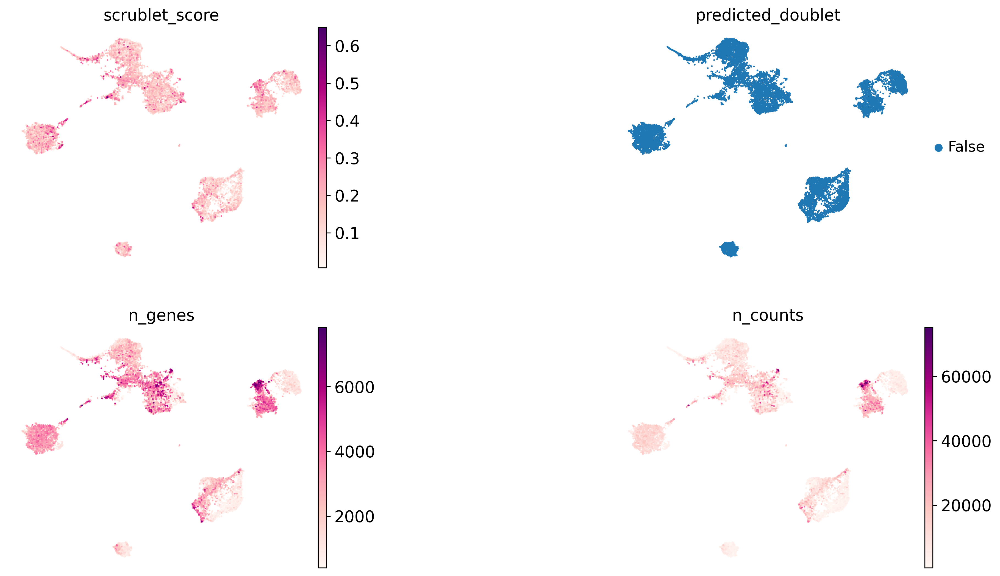

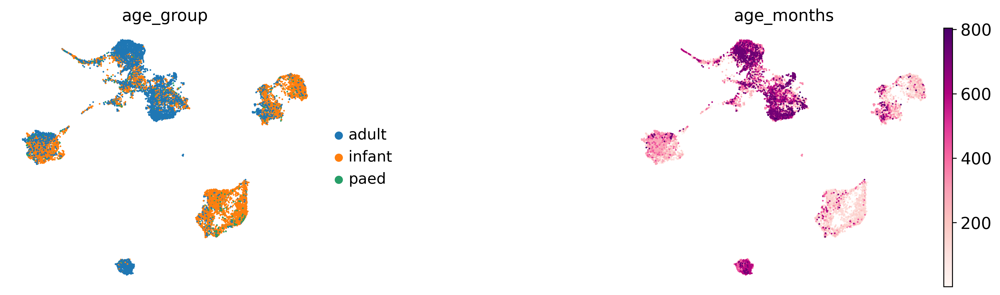

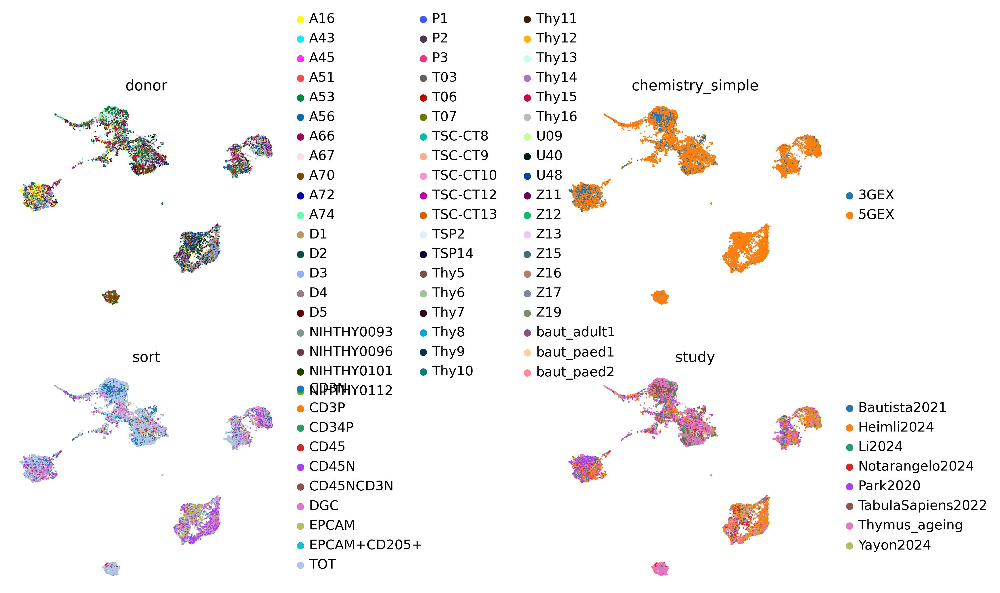

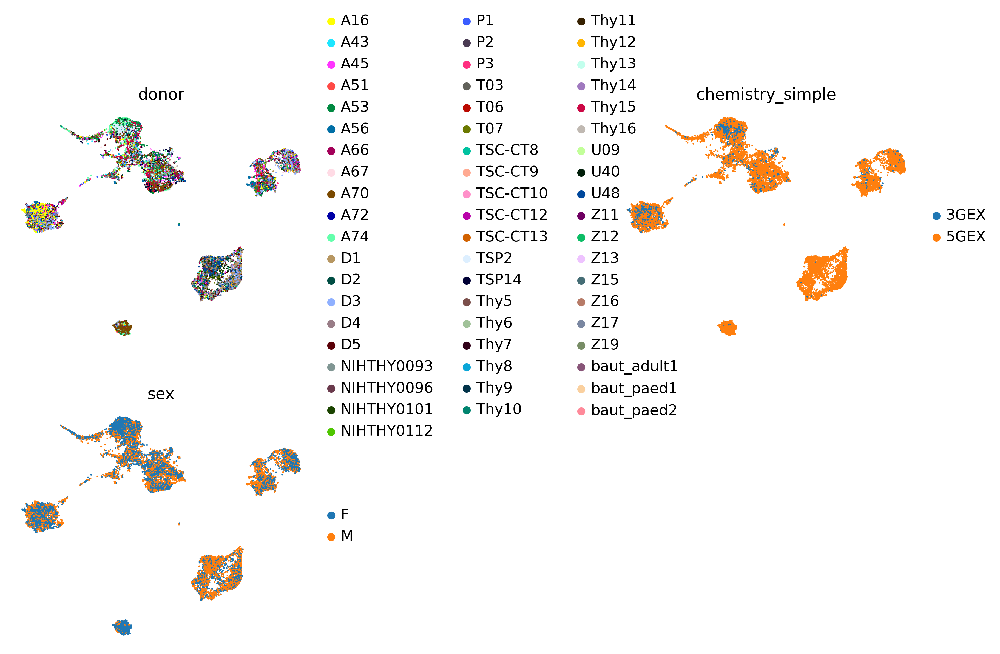

In [15]:
scvi_run = run_scvi(adata, 
                    # Excluded genes
                    include_genes=[], exclude_cc_genes=True, exclude_mt_genes=True, 
                    exclude_vdjgenes = True, remove_cite = False,
                    # Highly variable gene selection
                    batch_hv="age_group", hvg = 10000, span = 0.5,
                    # scVI 
                    batch_scvi="sample",
                    cat_cov_scvi=["donor", "chemistry_simple", "sex"], 
                    cont_cov_scvi=None, max_epochs=300,
                 #   max_epochs=400, batch_size=2000, # early_stopping = True, early_stopping_patience = 10, early_stopping_min_delta = 10,
                    check_val_every_n_epoch = 1,
                    plan_kwargs = {'lr': 0.0001}, n_layers = 2, n_latent = 30, dispersion = 'gene-batch',
                    # Leiden clustering
                    leiden_clustering = None, col_cell_type = 'taa_l4', 
                    covs = {'doublet_metric': ['scrublet_score', 'predicted_doublet', 'n_genes', 'n_counts'],
                    'age': ['age_group', 'age_months'],
                    'batch_mixing': ['donor', 'chemistry_simple', 'sort', 'study']})

In [16]:
# Save adata and scvi model
scvi_embed_version = 'scvi_v2_2024-11-05_myeloidSplit'
scvi_obj_version = f'v3_2layers_300epochs_{datetime.now().strftime("%Y-%m-%d")}'
overwrite = True

#anno_cols = [c for c in scvi_run['data'].obs.columns if '_pred_' in c or '_prop_' in c]
if not os.path.exists(f'{data_path}/objects/thyAgeing_{scvi_embed_version}_{scvi_obj_version}.zarr') or overwrite:
#    scvi_run['data'].obs = scvi_run['data'].obs.drop(columns=anno_cols)
    scvi_run['data'].write_h5ad(
        f'{data_path}/objects/thyAgeing_{scvi_embed_version}_{scvi_obj_version}.zarr',
        compression=hdf5plugin.FILTERS["zstd"],
        compression_opts=hdf5plugin.Zstd(clevel=5).filter_options,
    )
    scvi_run['vae'].save(f'{model_path}/thyAgeing_{scvi_embed_version}_{scvi_obj_version}', save_anndata=True, overwrite=True)
else:
    print('File already exists')



In [17]:
adata = scvi_run['data'].copy()

### Load adata for further analysis

In [5]:
scvi_embed_version = 'scvi_v2_2024-11-05_myeloidSplit'

In [6]:
adata = ad.read_h5ad(f'{data_path}/objects/thyAgeing_scvi_v2_2024-11-05_myeloidSplit_v3_2layers_300epochs_2025-02-04.zarr')

In [7]:
vae = scvi.model.SCVI.load(f"{model_path}/thyAgeing_scvi_v2_2024-11-05_myeloidSplit_v3_2layers_300epochs_2025-02-04")

INFO     File                                                                                                      
         /nfs/team205/vk8/projects/thymus_ageing_atlas/Myeloid_compartment/models/thyAgeing_scvi_v2_2024-11-05_myel
         oidSplit_v3_2layers_300epochs_2025-02-04/model.pt already downloaded                                      


In [8]:
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)

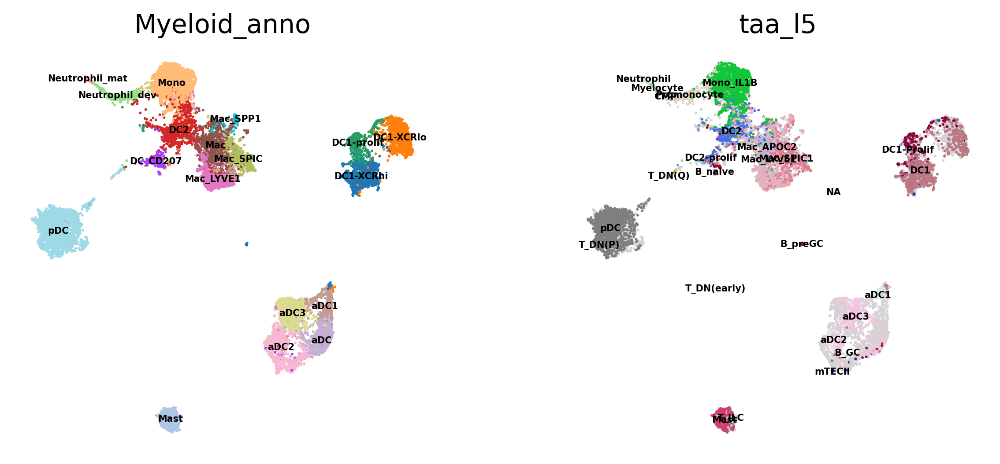

In [13]:
sc.pl.umap(adata, color = ['Myeloid_anno', 'taa_l5'], legend_loc = 'on data', legend_fontsize = 5, frameon = False)

In [15]:
adata.obs.rename(columns = {'taa_l5': 'taa_l5_old', 'Myeloid_anno':'taa_l5'}, inplace = True)

In [17]:
from utils import update_obs
metafull = pd.read_excel(f'{general_data_path}/metadata/Thymus_ageing_metadata_v25_2025-01-28.xlsx')
ctype_hier = pd.read_excel(f'{general_data_path}/curated/thyAgeing_full_curatedAnno_v7_2025-02-05_levels.xlsx')

In [18]:
update_obs(adata, metafull, update_cols = ['age_group'], on = 'sample')
update_obs(adata, ctype_hier, update_cols = ['taa_l4', 'taa_l3', 'taa_l2', 'taa_l1','taa_l0'], on = 'taa_l5')

Updating columns: ['age_group']
On columns: sample
Updating columns: ['taa_l4', 'taa_l3', 'taa_l2', 'taa_l1', 'taa_l0']
On columns: taa_l5


In [19]:
import celltypist
model_taa_l1 = celltypist.Model.load('/lustre/scratch126/cellgen/team205/lm25/thymus_projects/thymus_ageing_atlas/General_analysis/models/Celltypist_mod_thyAge_scvi_v2_pop_mrkrs_taa_l1_2024-12-10.pkl')

predictions_l1 = celltypist.annotate(adata, model=model_taa_l1, majority_voting = True)
predictions_l1.to_adata(prefix='ctypist_taa_l1')

model_taa_l4 = celltypist.Model.load('/lustre/scratch126/cellgen/team205/lm25/thymus_projects/thymus_ageing_atlas/General_analysis/models/Celltypist_mod_thyAge_scvi_v2_pop_mrkrs_taa_l4_2024-12-10.pkl')

predictions_l4 = celltypist.annotate(adata, model=model_taa_l4, majority_voting = True)
predictions_l4.to_adata(prefix='ctypist_taa_l4')

🔬 Input data has 14706 cells and 35530 genes
🔗 Matching reference genes in the model
🧬 3962 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!
👀 Detected a neighborhood graph in the input object, will run over-clustering on the basis of it
⛓️ Over-clustering input data with resolution set to 10
🗳️ Majority voting the predictions
✅ Majority voting done!


AnnData object with n_obs × n_vars = 14706 × 35530
    obs: 'barcode', 'sample', 'library', 'index', 'library_tcr_ab', 'library_tcr_gd', 'library_bcr', 'path_raw_gex', 'starsolo_version', 'path_cellbender_gex', 'path_cellranger_arc', 'donor', 'chemistry_simple', 'chemistry_detail', 'chemistry_orig', 'origin_institute', 'research_no', 'study', 'sort', 'sort_type', 'in_HTSA', 'public_data', 'type', 'cite', 'health_status', 'age_group', 'age_group2', 'age', 'age_num', 'age_unit', 'age_cont', 'sex', 'age_months', 'path_tcr_ab', 'path_tcr_gd', 'path_bcr', 'comment', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'percent_hb', 'scrublet_score', 'predicted_doublet', 'taa_l5_old', 'taa_l4', 'taa_l3', 'taa_l2', 'taa_l1', 'taa_l0', 'taa_l5', 'ctypist_taa_l1predicted_labels', 'ctypist_taa_l1over_clustering', 'ctypist_taa_l1majority_voting', 'ctypist_taa_l1conf_score'
    var: 'gene_ids', 'gene_name', 'n_counts', 'n_cells'
    uns: '_scvi_manager_uuid', '_scvi_uuid', 'age_group_colors', 'c

🔬 Input data has 14706 cells and 35530 genes
🔗 Matching reference genes in the model
🧬 6783 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!
👀 Detected a neighborhood graph in the input object, will run over-clustering on the basis of it
⛓️ Over-clustering input data with resolution set to 10
🗳️ Majority voting the predictions
✅ Majority voting done!


AnnData object with n_obs × n_vars = 14706 × 35530
    obs: 'barcode', 'sample', 'library', 'index', 'library_tcr_ab', 'library_tcr_gd', 'library_bcr', 'path_raw_gex', 'starsolo_version', 'path_cellbender_gex', 'path_cellranger_arc', 'donor', 'chemistry_simple', 'chemistry_detail', 'chemistry_orig', 'origin_institute', 'research_no', 'study', 'sort', 'sort_type', 'in_HTSA', 'public_data', 'type', 'cite', 'health_status', 'age_group', 'age_group2', 'age', 'age_num', 'age_unit', 'age_cont', 'sex', 'age_months', 'path_tcr_ab', 'path_tcr_gd', 'path_bcr', 'comment', 'n_counts', 'n_genes', 'percent_mito', 'percent_ribo', 'percent_hb', 'scrublet_score', 'predicted_doublet', 'taa_l5_old', 'taa_l4', 'taa_l3', 'taa_l2', 'taa_l1', 'taa_l0', 'taa_l5', 'ctypist_taa_l1predicted_labels', 'ctypist_taa_l1over_clustering', 'ctypist_taa_l1majority_voting', 'ctypist_taa_l1conf_score', 'ctypist_taa_l4predicted_labels', 'ctypist_taa_l4over_clustering', 'ctypist_taa_l4majority_voting', 'ctypist_taa_l4conf_sc

In [20]:
## Add annotation from additional sources
from celltypist import models
model_panfetal = models.Model.load('Pan_Fetal_Human.pkl')
model_immune = models.Model.load('Immune_All_High.pkl')

In [21]:
from utils_vk8 import ctypist_anno

🔬 Input data has 14706 cells and 35530 genes
🔗 Matching reference genes in the model
🧬 7118 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!
👀 Detected a neighborhood graph in the input object, will run over-clustering on the basis of it
⛓️ Over-clustering input data with resolution set to 10
🗳️ Majority voting the predictions
✅ Majority voting done!
... storing 'sample' as categorical
... storing 'age_group' as categorical
... storing 'taa_l4' as categorical
... storing 'taa_l3' as categorical
... storing 'taa_l2' as categorical
... storing 'taa_l1' as categorical
... storing 'taa_l0' as categorical
... storing 'taa_l5' as categorical


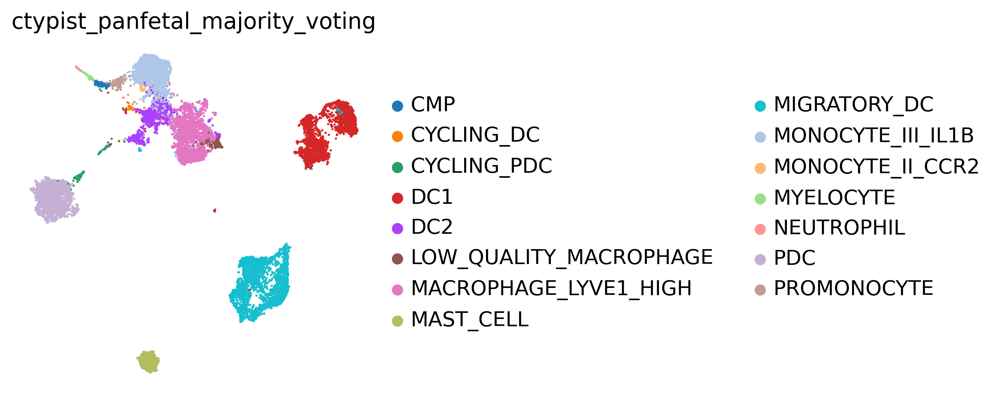

In [22]:
ctypist_anno(adata, model = model_panfetal, col_name = 'panfetal', mv=True)

🔬 Input data has 14706 cells and 35530 genes
🔗 Matching reference genes in the model
🧬 6145 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!
👀 Detected a neighborhood graph in the input object, will run over-clustering on the basis of it
⛓️ Over-clustering input data with resolution set to 10
🗳️ Majority voting the predictions
✅ Majority voting done!


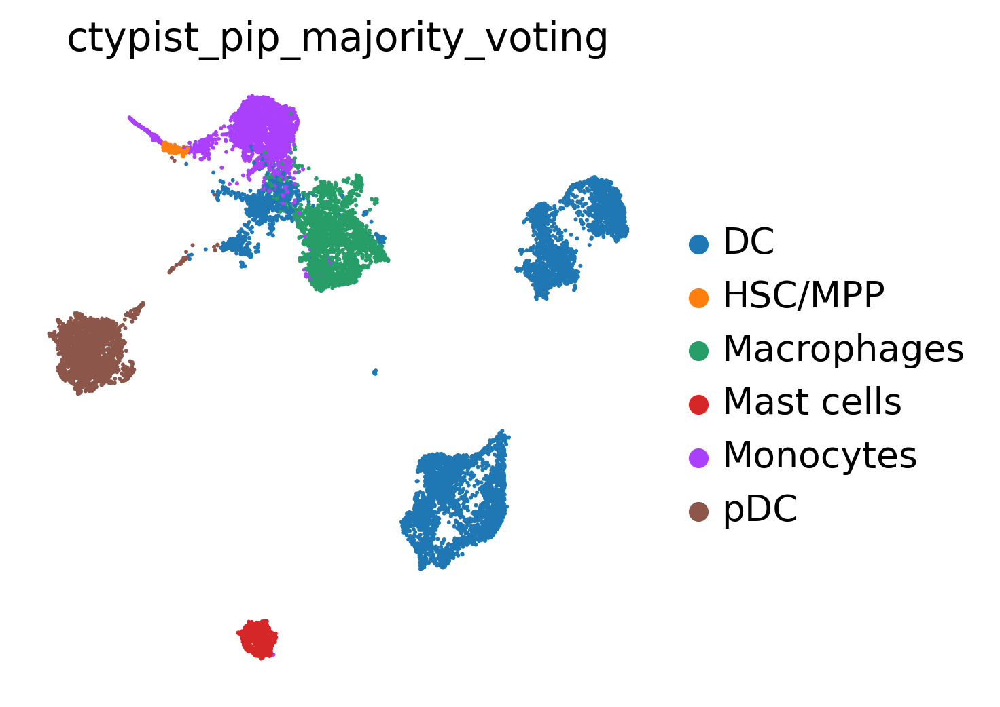

In [23]:
ctypist_anno(adata, model = model_immune, col_name = 'pip', mv=True)

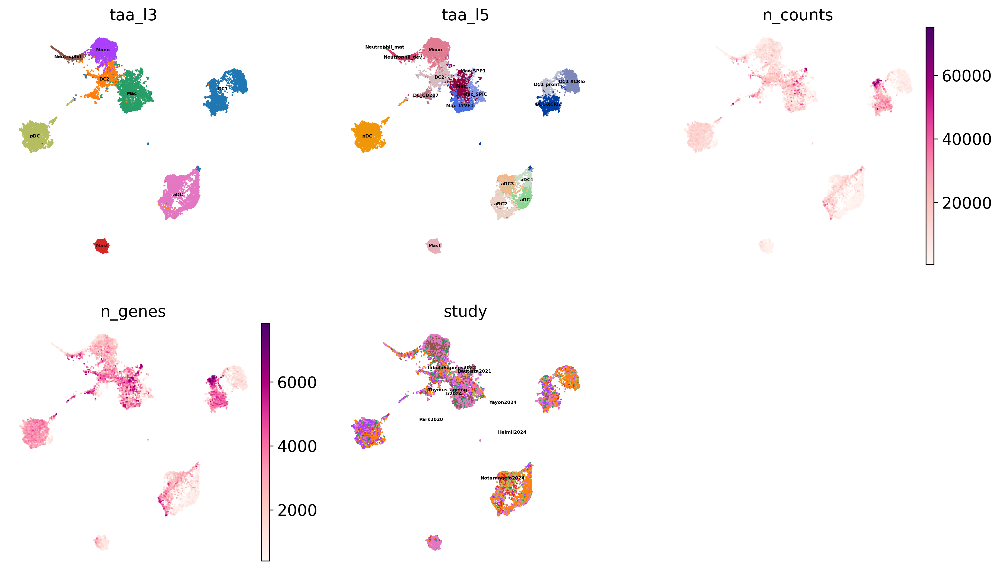

In [29]:
sc.pl.umap(adata, color = ['taa_l3', 'taa_l5', 'n_counts', 'n_genes', 'study'], legend_loc = 'on data', legend_fontsize = 4, ncols = 3, frameon = False)

In [29]:
from utils_vk8 import run_leiden

In [30]:
adata.obs['taa_l5'].value_counts()

taa_l5
pDC               2236
Mono              1763
aDC2              1083
Mac               1056
DC1-XCRlo         1047
DC1-XCRhi          958
aDC3               915
DC2                873
Mac_LYVE1          802
aDC                795
Mast               660
Mac_SPIC           633
DC1-prolif         564
Neutrophil_dev     405
aDC1               398
DC_CD207           297
Mac_SPP1           144
Neutrophil_mat      77
Name: count, dtype: int64

In [35]:
adata.obs['ctypist_panfetal_majority_voting'].value_counts()

ctypist_panfetal_majority_voting
MIGRATORY_DC              3278
DC1                       2524
MACROPHAGE_LYVE1_HIGH     2413
PDC                       2147
MONOCYTE_III_IL1B         1930
DC2                        885
MAST_CELL                  661
LOW_QUALITY_MACROPHAGE     205
PROMONOCYTE                162
CMP                        160
CYCLING_PDC                 97
MYELOCYTE                   85
NEUTROPHIL                  69
MONOCYTE_II_CCR2            57
CYCLING_DC                  33
Name: count, dtype: int64

In [36]:
adata.obs['Myeloid_anno'] = adata.obs.apply(lambda x: x['ctypist_panfetal_majority_voting'] if 
                            x['ctypist_panfetal_majority_voting'] in ['CMP', 'PROMONOCYTE', 'MYELOCYTE', 'NEUTROPHIL'] else
                                                     x['taa_l5'], axis = 1)

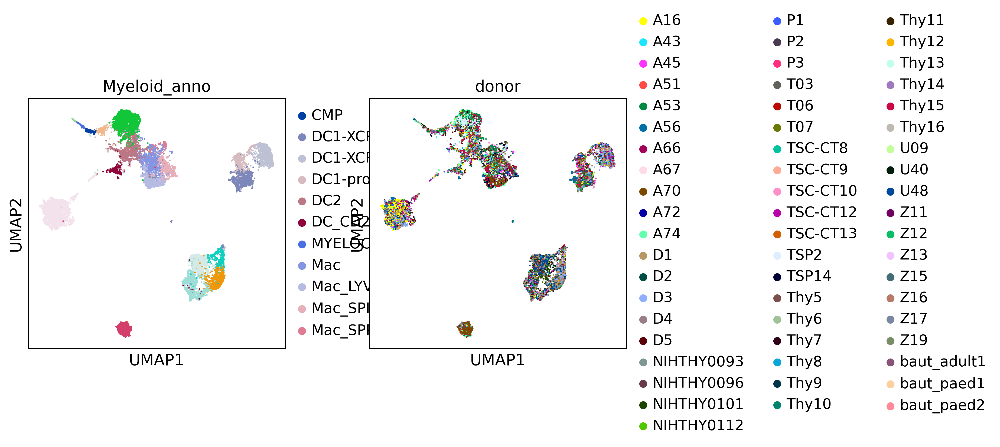

In [83]:
sc.pl.umap(adata, color = ['Myeloid_anno', 'donor'])

In [40]:
from utils_vk8 import run_leiden

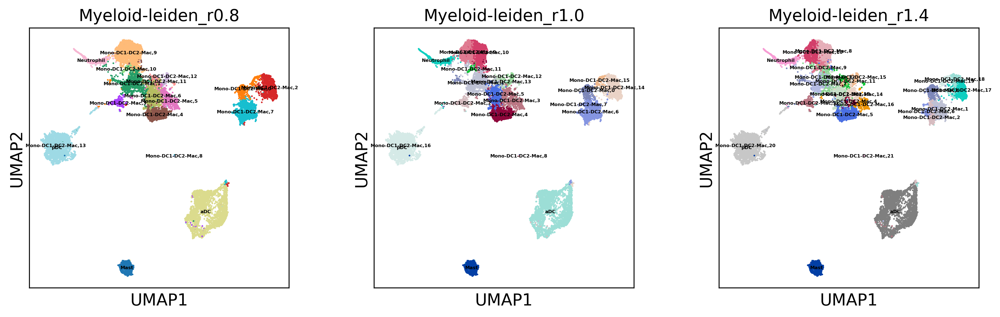

In [42]:
run_leiden(adata, resolutions = [0.8, 1.0, 1.4], key_name = 'Myeloid', restrict_to=['taa_l3', ['Mono', 'DC1', 'DC2', 'Mac']])

In [50]:
adata.obs['Myeloid-leiden_r1.0'] = adata.obs['Myeloid-leiden_r1.0'].cat.rename_categories([i.replace('Mono-DC1-DC2-Mac', 'Mye') for i in adata.obs['Myeloid-leiden_r1.0'].cat.categories])

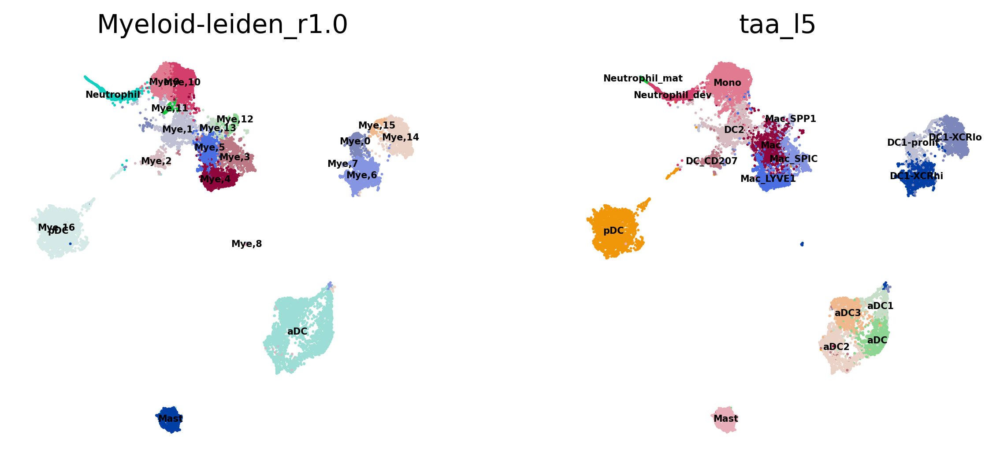

In [65]:
sc.pl.umap(adata, color = ['Myeloid-leiden_r1.0', 'taa_l5'], legend_loc = 'on data',legend_fontsize=5, frameon = False)

In [81]:
adata.obs

,barcode,sample,library,index,library_tcr_ab,library_tcr_gd,library_bcr,path_raw_gex,starsolo_version,path_cellbender_gex,path_cellranger_arc,donor,chemistry_simple,chemistry_detail,chemistry_orig,origin_institute,research_no,study,sort,sort_type,in_HTSA,public_data,type,cite,health_status,age_group,age_group2,age,age_num,age_unit,age_cont,sex,age_months,path_tcr_ab,path_tcr_gd,path_bcr,comment,n_counts,n_genes,percent_mito,percent_ribo,percent_hb,scrublet_score,predicted_doublet,taa_l5_old,taa_l4,taa_l3,taa_l2,taa_l1,taa_l0,taa_l5,ctypist_taa_l1predicted_labels,ctypist_taa_l1over_clustering,ctypist_taa_l1majority_voting,ctypist_taa_l1conf_score,ctypist_taa_l4predicted_labels,ctypist_taa_l4over_clustering,ctypist_taa_l4majority_voting,ctypist_taa_l4conf_score,ctypist_panfetal_predicted_labels,ctypist_panfetal_over_clustering,ctypist_panfetal_majority_voting,ctypist_panfetal_conf_score,ctypist_pip_predicted_labels,ctypist_pip_over_clustering,ctypist_pip_majority_voting,ctypist_pip_conf_score,Myeloid_anno,Myeloid-leiden_r0.8,Myeloid-leiden_r1.0,Myeloid-leiden_r1.4
TA13072046-ATGTGTGTCTCTAAGG,ATGTGTGTCTCTAAGG,A67-THY-0-SC-FACS-3_5GEX,TA13072046,TA13072046,NaN,NaN,NaN,/lustre/scratch126/cellgen/team205/vk8/irods_d...,2.7.4a,/lustre/scratch126/cellgen/team205/vk8/irods_d...,nan,A67,5GEX,10x 5' v2.0,5'v2,CBTM,19/0067,Thymus_ageing,EPCAM+CD205+,FACS,no,no,cells,False,healthy,adult,adult(early),20y,20,y,20,M,240.0,NaN,NaN,NaN,NaN,59170,6810,0.034697,0.220686,0.000051,0.163934,False,NaN,DC1-prolif,DC1,DC1,DC,Myeloid,DC1-prolif,DC,3,DC,0.999997,DC1,3,DC1,0.946176,DC1,3,DC1,0.994780,DC,3,DC,0.817269,DC1-prolif,"Mono-DC1-DC2-Mac,0","Mye,0","Mono-DC1-DC2-Mac,0"
TA13072046-GGGTTGCGTGATGTCT,GGGTTGCGTGATGTCT,A67-THY-0-SC-FACS-3_5GEX,TA13072046,TA13072046,NaN,NaN,NaN,/lustre/scratch126/cellgen/team205/vk8/irods_d...,2.7.4a,/lustre/scratch126/cellgen/team205/vk8/irods_d...,nan,A67,5GEX,10x 5' v2.0,5'v2,CBTM,19/0067,Thymus_ageing,EPCAM+CD205+,FACS,no,no,cells,False,healthy,adult,adult(early),20y,20,y,20,M,240.0,NaN,NaN,NaN,NaN,21912,4836,0.029071,0.282676,0.000046,0.154047,False,NaN,DC_CD207,DC2,DC2,DC,Myeloid,DC_CD207,DC,7,DC,0.996186,DC2,7,DC2,0.373249,DN(early)_T,7,DC2,0.329462,DC,7,DC,0.810279,DC_CD207,"Mono-DC1-DC2-Mac,3","Mye,2","Mono-DC1-DC2-Mac,3"
TA13072046-TTGTAGGGTACTCTCC,TTGTAGGGTACTCTCC,A67-THY-0-SC-FACS-3_5GEX,TA13072046,TA13072046,NaN,NaN,NaN,/lustre/scratch126/cellgen/team205/vk8/irods_d...,2.7.4a,/lustre/scratch126/cellgen/team205/vk8/irods_d...,nan,A67,5GEX,10x 5' v2.0,5'v2,CBTM,19/0067,Thymus_ageing,EPCAM+CD205+,FACS,no,no,cells,False,healthy,adult,adult(early),20y,20,y,20,M,240.0,NaN,NaN,NaN,NaN,4750,1305,0.030737,0.356421,0.000000,0.250000,False,Promonocyte,Neutrophil_dev,Neutrophil,Neutrophil,Neutrophil,Myeloid,Neutrophil_dev,Myeloid_dev,92,Myeloid_dev,1.000000,Promonocyte,92,Myelocyte,0.934426,CMP,92,MYELOCYTE,0.092120,Promyelocytes,92,Monocytes,0.127210,MYELOCYTE,Neutrophil,Neutrophil,Neutrophil
TA13072046-TTAGTTCTCTGTCTAT,TTAGTTCTCTGTCTAT,A67-THY-0-SC-FACS-3_5GEX,TA13072046,TA13072046,NaN,NaN,NaN,/lustre/scratch126/cellgen/team205/vk8/irods_d...,2.7.4a,/lustre/scratch126/cellgen/team205/vk8/irods_d...,nan,A67,5GEX,10x 5' v2.0,5'v2,CBTM,19/0067,Thymus_ageing,EPCAM+CD205+,FACS,no,no,cells,False,healthy,adult,adult(early),20y,20,y,20,M,240.0,NaN,NaN,NaN,NaN,1796,720,0.002784,0.060690,0.000557,0.109278,False,Mac_SPIC1,Mac_LYVE1,Mac,Mac,Mac,Myeloid,Mac_LYVE1,Mac,99,Mac,1.000000,Mac_SPIC1,99,Mac_SPIC1,0.996764,MACROPHAGE_LYVE1_HIGH,99,MACROPHAGE_LYVE1_HIGH,0.560182,Macrophages,99,Macrophages,0.999727,Mac_LYVE1,"Mono-DC1-DC2-Mac,4","Mye,3","Mono-DC1-DC2-Mac,4"
TA13072046-CTGTTTAAGTGACTCT,CTGTTTAAGTGACTCT,A67-THY-0-SC-FACS-3_5GEX,TA13072046,TA13072046,NaN,NaN,NaN,/lustre/scratch126/cellgen/team205/vk8/irods_d...,2.7.4a,/lustre/scratch126/cellgen/team205/vk8/irods_d...,nan,A67,5GEX,10x 5' v2.0,5'v2,CBTM,19/0067,Thymus_ageing,EPCAM+CD205+,FACS,no,no,cells,False,healthy,adult,adult(early),20y,20,y,20,M,240.0,NaN,NaN,NaN,NaN,1491,68

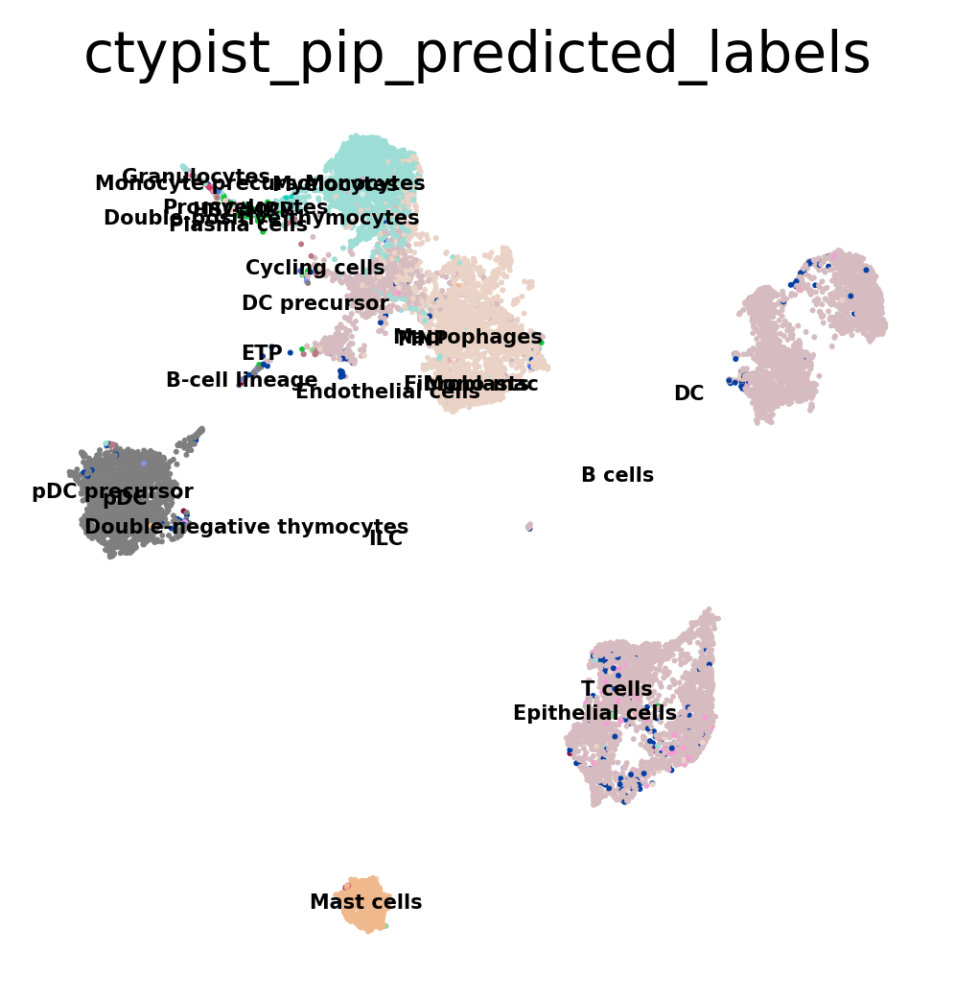

In [82]:
sc.pl.umap(adata, color = ['ctypist_pip_predicted_labels'], legend_loc = 'on data',legend_fontsize=5, frameon = False)

In [59]:
sc.tl.dendrogram(adata, groupby = 'Myeloid-leiden_r1.0', use_rep = 'X_scVI')

In [52]:
from utils_vk8 import scvi_markers

In [54]:
mye_mrkrs = scvi_markers(vae, cluster = 'Myeloid-leiden_r1.0', adata = adata)

DE...: 100%|██████████████████████████████████████████████████████████████████████████| 21/21 [02:04<00:00,  5.95s/it]


In [66]:
pd.crosstab(adata.obs['taa_l5'], adata.obs['Myeloid-leiden_r1.0'])

Myeloid-leiden_r1.0,Mast,"Mye,0","Mye,1","Mye,2","Mye,3","Mye,4","Mye,5","Mye,6","Mye,7","Mye,8","Mye,9","Mye,10","Mye,11","Mye,12","Mye,13","Mye,14","Mye,15","Mye,16",Neutrophil,aDC,pDC
taa_l5,,,,,,,,,,,,,,,,,,,,,
DC1-XCRhi,0,9,0,0,0,0,0,899,20,20,0,0,0,0,0,9,0,1,0,0,0
DC1-XCRlo,0,2,1,1,0,0,0,33,0,0,0,0,0,0,0,972,38,0,0,0,0
DC1-prolif,0,334,1,0,1,0,0,124,0,0,0,0,0,0,0,5,99,0,0,0,0
DC2,0,26,692,11,10,11,28,1,0,0,14,73,1,0,6,0,0,0,0,0,0
DC_CD207,0,2,11,282,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
Mac,0,0,34,0,218,60,508,0,0,0,2,9,2,41,182,0,0,0,0,0,0
Mac_LYVE1,0,0,3,0,16,663,111,0,0,0,2,4,0,2,1,0,0,0,0,0,0
Mac_SPIC,0,0,3,4,564,46,7,0,0,0,0,0,0,2,6,1,0,0,0,0,0
Mac_SPP1,0,0,10,0,4,2,8,0,0,0,0,1,0,111,8,0,0,0,0,0,0


In [77]:
mye_mrkrs['de_df'].loc[mye_mrkrs['de_df']['cluster'] == 'Mye,14'].iloc[0:30]

,proba_de,proba_not_de,bayes_factor,scale1,scale2,pseudocounts,delta,lfc_mean,lfc_median,lfc_std,lfc_min,lfc_max,raw_mean1,raw_mean2,non_zeros_proportion1,non_zeros_proportion2,raw_normalized_mean1,raw_normalized_mean2,is_de_fdr_0.05,comparison,group1,group2,cluster
LGALS2,0.9878,0.0122,4.394043,7.902588e-03,0.000944,0.0,0.25,4.445845,4.631826,2.370689,-2.892841,11.093510,7.043566,2.900940,0.946302,0.314746,74.315577,8.604272,True,"Mye,14 vs Rest","Mye,14",Rest,"Mye,14"
LINC00882,0.9866,0.0134,4.299009,5.463472e-05,0.000006,0.0,0.25,3.862875,4.002641,1.749813,-2.730233,10.296035,0.044580,0.009840,0.038501,0.008237,0.462687,0.021979,True,"Mye,14 vs Rest","Mye,14",Rest,"Mye,14"
CHST11,0.9860,0.0140,4.254598,4.138958e-06,0.000078,0.0,0.25,-3.948134,-4.213787,1.908584,-9.058776,3.965292,0.004053,0.249362,0.004053,0.168671,0.066533,0.775917,True,"Mye,14 vs Rest","Mye,14",Rest,"Mye,14"
SNX3,0.9858,0.0142,4.240211,7.729381e-03,0.001149,0.0,0.25,3.138221,3.293840,1.233940,-1.579602,6.540405,7.350557,4.192215,0.962513,0.651651,78.558351,11.174003,True,"Mye,14 vs Rest","Mye,14",Rest,"Mye,14"
GAB1,0.9856,0.0144,4.226022,1.692571e-06,0.000032,0.0,0.25,-3.685477,-3.743597,1.897071,-9.528336,3.084278,0.001013,0.077046,0.001013,0.060719,0.009347,0.269494,True,"Mye,14 vs Rest","Mye,14",Rest,"Mye,14"
PPY,0.9852,0.0148,4.198217,2.068793e-04,0.000019,0.0,0.25,4.645302,4.803330,2.163001,-3.913094,10.671560,0.176292,0.065530,0.142857,0.037029,2.077290,0.114910,True,"Mye,14 vs Rest","Mye,14",Rest,"Mye,14"
Z93241.1,0.9850,0.0150,4.184591,4.234977e-06,0.000106,0.0,0.25,-4.267362,-4.386435,2.196931,-11.336083,5.184393,0.003040,0.243312,0.003040,0.110795,0.060562,0.801800,True,"Mye,14 vs Rest","Mye,14",Rest,"Mye,14"
LINC02206,0.9848,0.0152,4.171142,1.411378e-04,0.000015,0.0,0.25,4.436496,4.669626,2.135303,-3.534025,10.501032,0.121581,0.054814,0.102330,0.034769,1.357860,0.102448,True,"Mye,14 vs Rest","Mye,14",Rest,"Mye,14"
LINC-PINT,0.9846,0.0154,4.157867,5.648588e-06,0.000151,0.0,0.25,-4.418724,-4.709884,2.475273,-11.991148,5.520760,0.000000,0.484875,0.000000,0.228224,0.000000,1.569611,True,"Mye,14 vs Rest","Mye,14",Rest,"Mye,14"
CASR,0.9846,0.0154,4.157867,3.637992e-07,0.000006,0.0,0.25,-3.435209,-3.378072,1.797368,-9.350163,3.410431,0.000000,0.003863,0.000000,0.003280,0.000000,0.012147,True,"Mye,14 vs Rest","Mye,14",Rest,"Mye,14"


In [78]:
adata.shape

(14706, 35530)

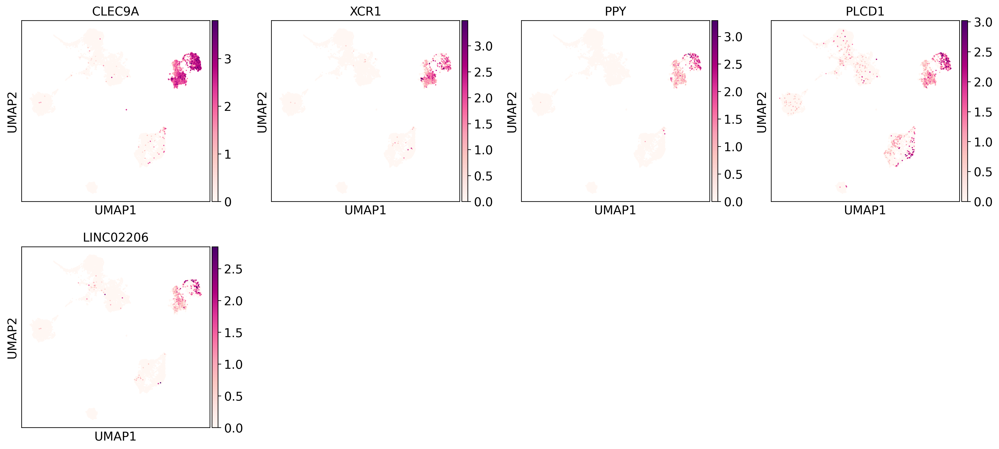

In [71]:
sc.pl.umap(adata, color = ['CLEC9A', 'XCR1', 'PPY', 'PLCD1', 'LINC02206', 'CCL4', 'FOSL2', ''])

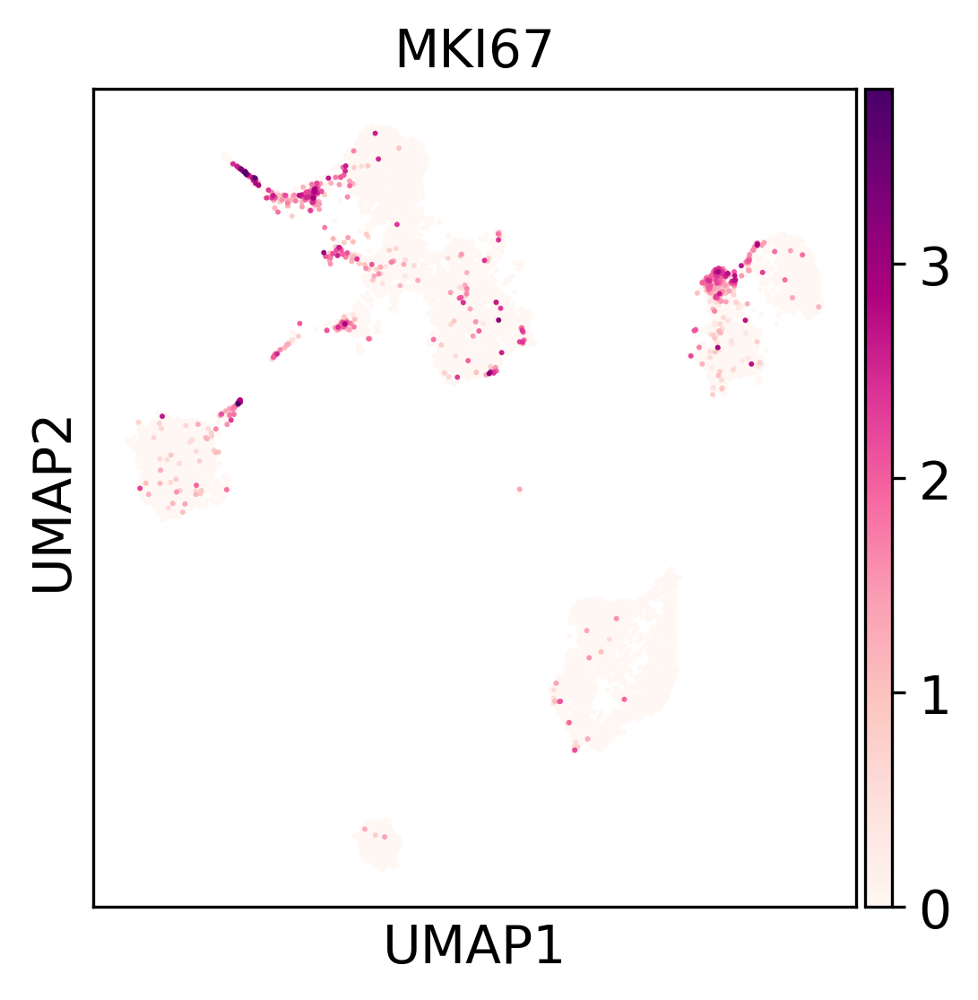

In [68]:
sc.pl.umap(adata, color = ['MKI67'])

In [67]:
adata.obs['Myeloid-leiden_r1.0'].value_counts()

Myeloid-leiden_r1.0
aDC           3191
pDC           2236
Mye,6         1057
Mye,14         987
Mye,10         874
Mye,1          830
Mye,3          816
Mye,4          792
Mye,9          768
Mye,5          666
Mast           660
Neutrophil     482
Mye,0          373
Mye,2          298
Mye,13         207
Mye,12         156
Mye,15         137
Mye,11         135
Mye,7           20
Mye,8           20
Mye,16           1
Name: count, dtype: int64

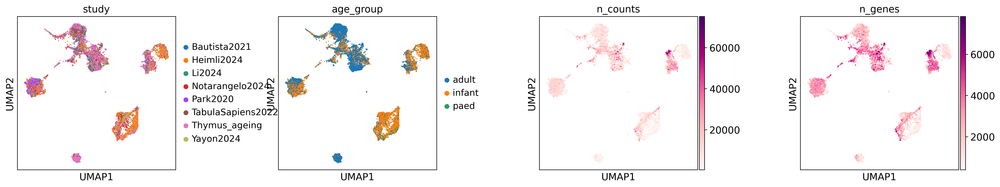

In [38]:
sc.pl.umap(adata, color = ['study', 'age_group', 'n_counts', 'n_genes'], wspace = 0.5)

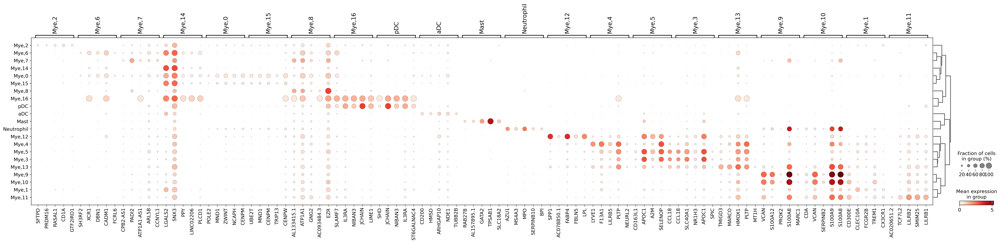

In [60]:
sc.pl.dotplot(adata, var_names = mye_mrkrs['markers'], groupby = 'Myeloid-leiden_r1.0', dendrogram=True)

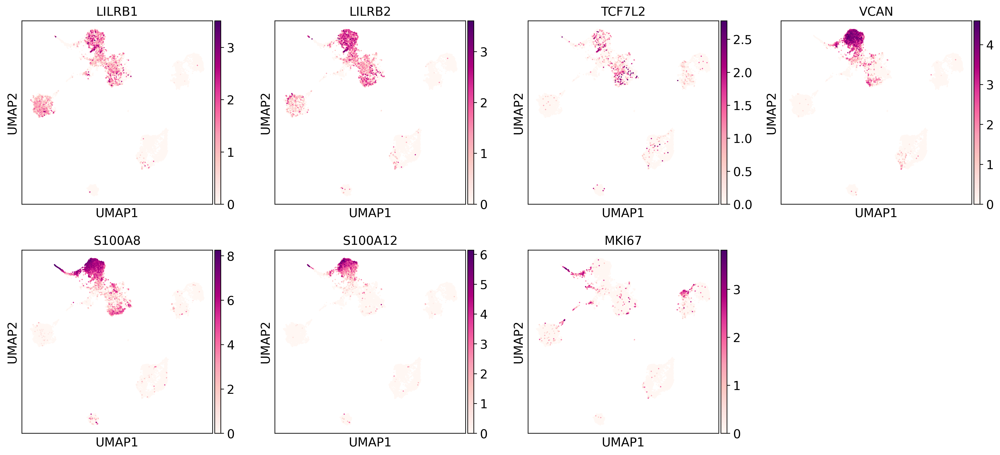

In [88]:
sc.pl.umap(adata, color = ['LILRB1', 'LILRB2', 'TCF7L2', 'VCAN', 'S100A8', 'S100A12', 'MKI67'])

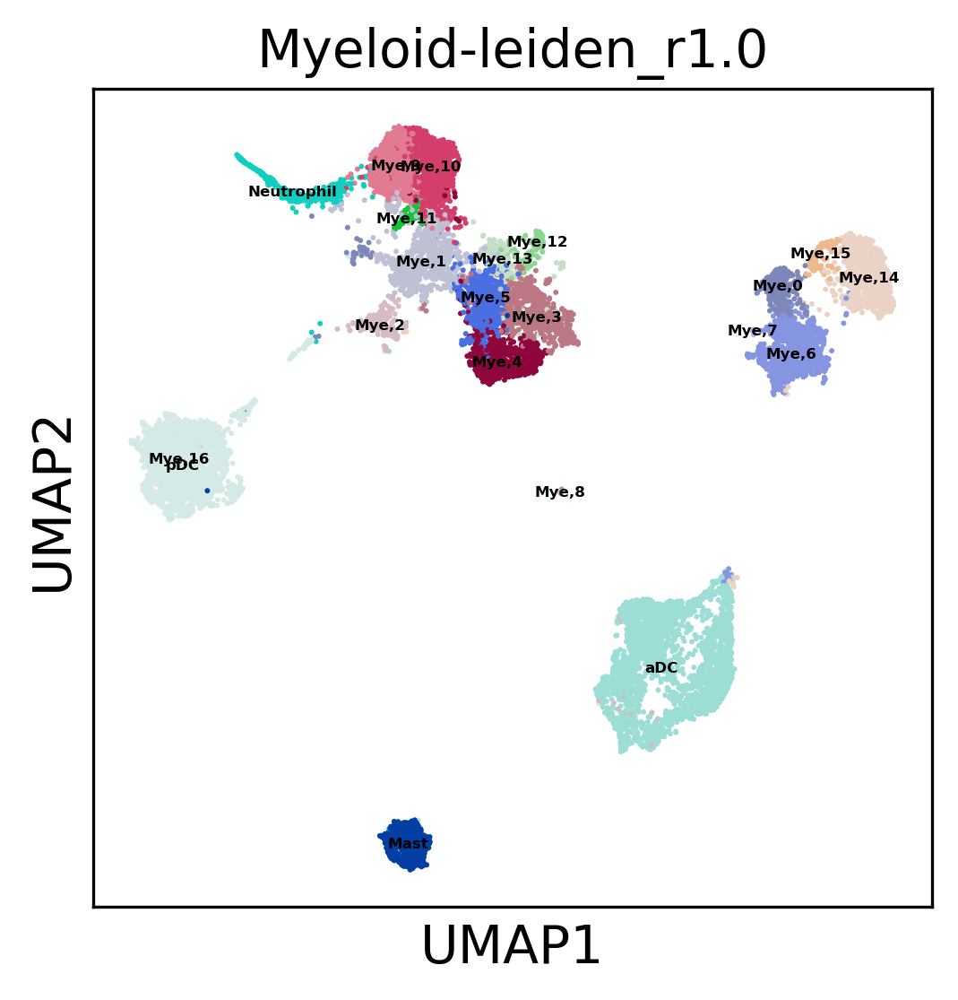

In [158]:
sc.pl.umap(adata, color = 'Myeloid-leiden_r1.0', legend_loc = 'on data', legend_fontsize = 4)

In [157]:
adata.obs['Myeloid-leiden_r1.0'].value_counts()

Myeloid-leiden_r1.0
aDC           3191
pDC           2236
Mye,6         1057
Mye,14         987
Mye,10         874
Mye,1          830
Mye,3          816
Mye,4          792
Mye,9          768
Mye,5          666
Mast           660
Neutrophil     482
Mye,0          373
Mye,2          298
Mye,13         207
Mye,12         156
Mye,15         137
Mye,11         135
Mye,7           20
Mye,8           20
Mye,16           1
Name: count, dtype: int64

In [159]:
adata.obs['Myeloid_anno2'] = adata.obs.apply(lambda x: 'DC2_SFTPD' if x['Myeloid-leiden_r1.0'] == 'Mye,2' else
                                            'DC2' if x['Myeloid-leiden_r1.0'] == 'Mye,1' else 
                                        #    'DC1-low_cnt' if x['Myeloid-leiden_r1.0'] in ['Mye,14', 'Mye,15'] else
                                            'DC1-prolif' if x['Myeloid-leiden_r1.0'] in ['Mye,0', 'Mye,15'] else
                                            'DC1' if x['Myeloid-leiden_r1.0'] in ['Mye,6', 'Mye,7', 'Mye,14'] else
                                             'DC-donor-sp' if x['Myeloid-leiden_r1.0'] == 'Mye,8' else
                                            'Mac_SPP1' if x['Myeloid-leiden_r1.0'] in ['Mye,12', 'Mye,13'] else
                                            'Mac_LYVE1' if x['Myeloid-leiden_r1.0']=='Mye,4' else
                                            'Mac' if x['Myeloid-leiden_r1.0']== 'Mye,5' else
                                            'Mac_SPIC1' if x['Myeloid-leiden_r1.0'] == 'Mye,3' else
                                            'Mono' if x['Myeloid-leiden_r1.0'] in ['Mye,9', 'Mye,10', 'Mye,11'] else
                                            'pDC' if x['Myeloid-leiden_r1.0'] == 'Mye,16' else
                                             x['Myeloid_anno'], axis = 1)

In [161]:
adata.obs['Myeloid_anno2'].value_counts()

Myeloid_anno2
pDC               2236
DC1               2064
Mono              1777
aDC2              1083
aDC3               915
DC2                830
Mac_SPIC1          816
aDC                795
Mac_LYVE1          792
Mac                666
Mast               660
DC1-prolif         510
aDC1               398
Mac_SPP1           363
DC2_SFTPD          298
CMP                160
PROMONOCYTE        143
MYELOCYTE           85
NEUTROPHIL          69
Neutrophil_dev      25
DC-donor-sp         20
Neutrophil_mat       1
Name: count, dtype: int64

... storing 'Myeloid_anno2' as categorical


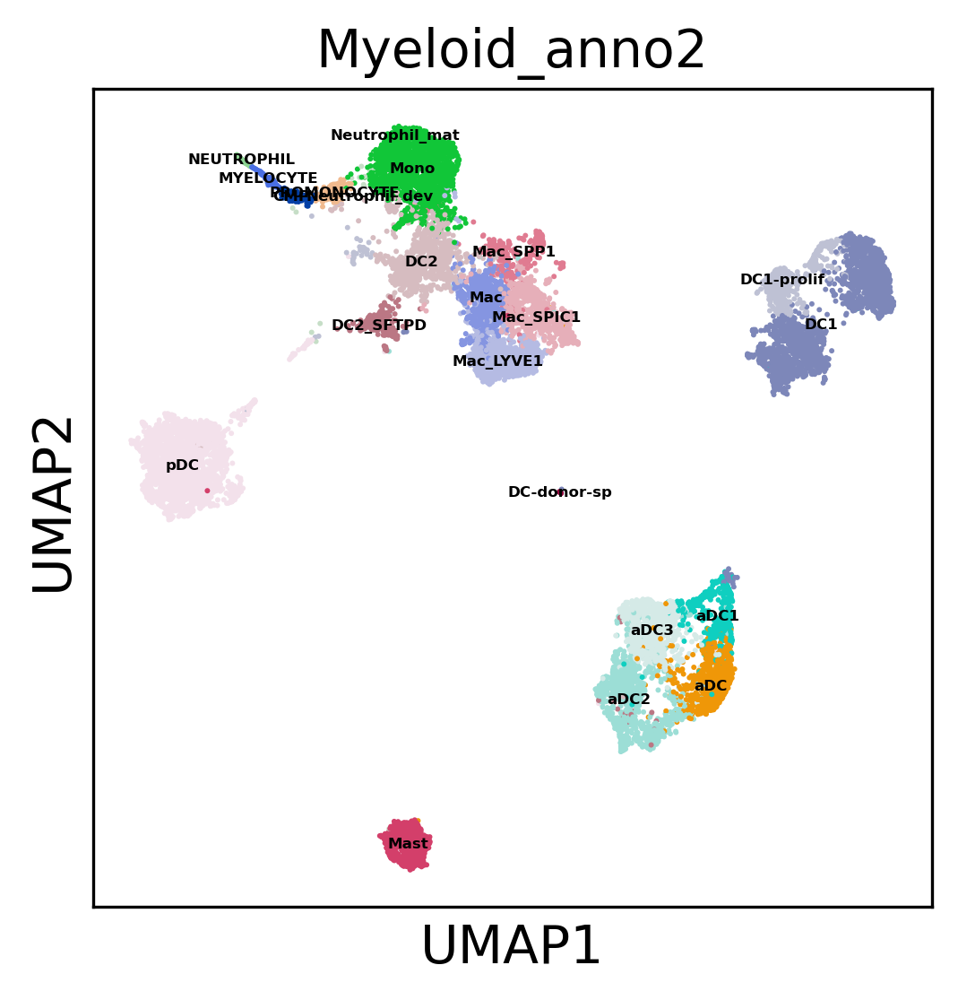

In [160]:
sc.pl.umap(adata, color = 'Myeloid_anno2', legend_loc = "on data", legend_fontsize = 4)

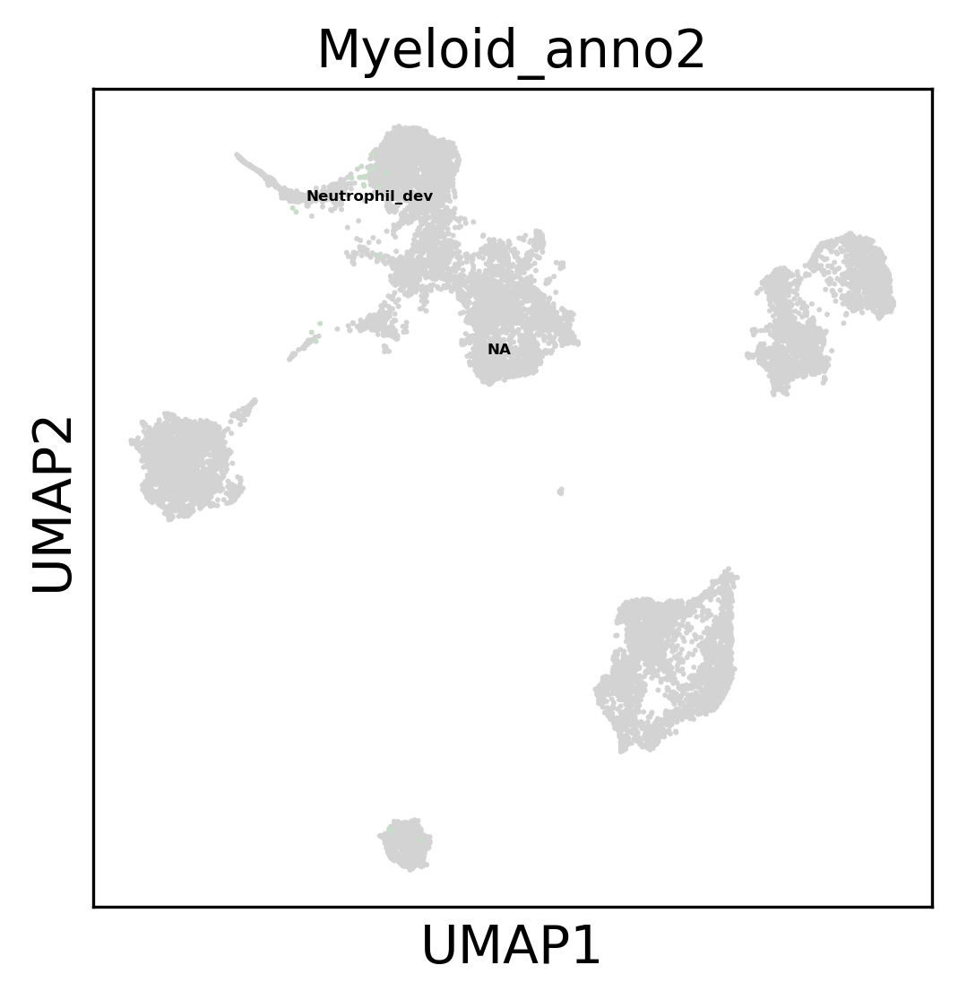

In [163]:
sc.pl.umap(adata, color = 'Myeloid_anno2', groups = ['Neutrophil_de'], legend_loc = "on data", legend_fontsize = 4)

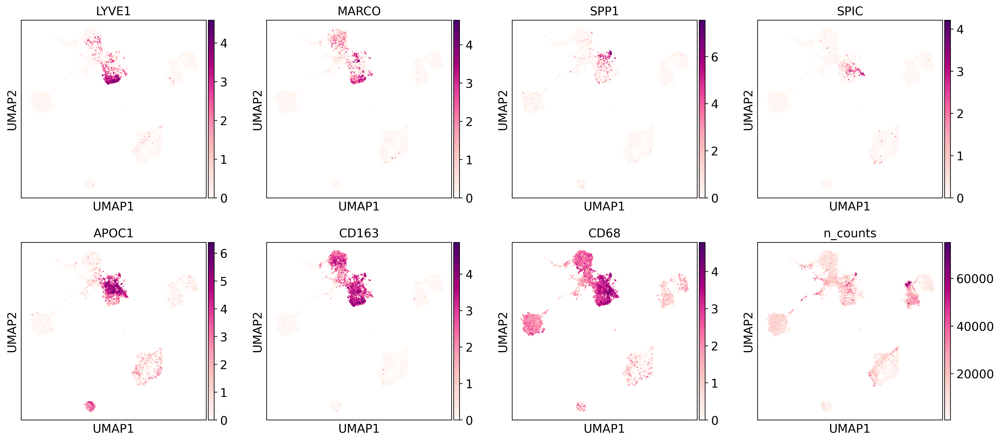

In [103]:
sc.pl.umap(adata, color = ['LYVE1', 'MARCO', 'SPP1', 'SPIC', 'APOC1', 'CD163', 'CD68', 'n_counts'])

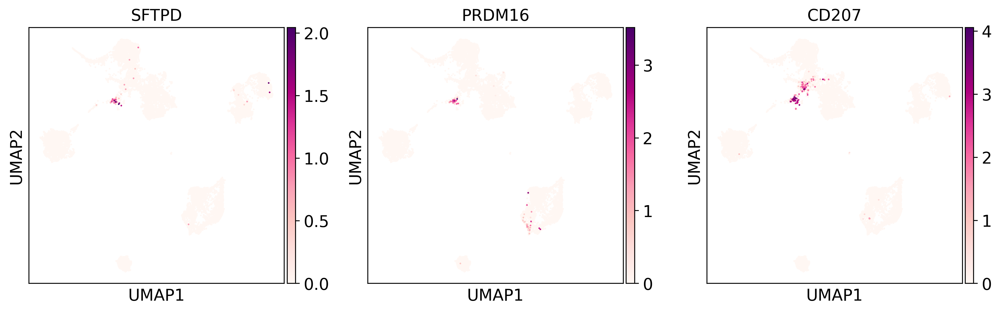

In [85]:
sc.pl.umap(adata, color = ['SFTPD', 'PRDM16', 'CD207'])

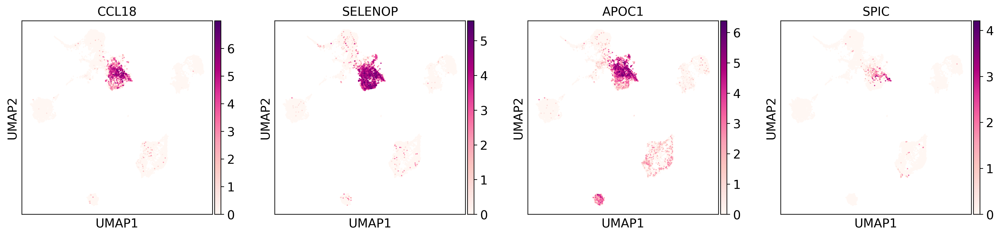

In [95]:
sc.pl.umap(adata, color = ['CCL18', 'SELENOP', 'APOC1', 'SPIC'])

... storing 'Myeloid_anno2' as categorical


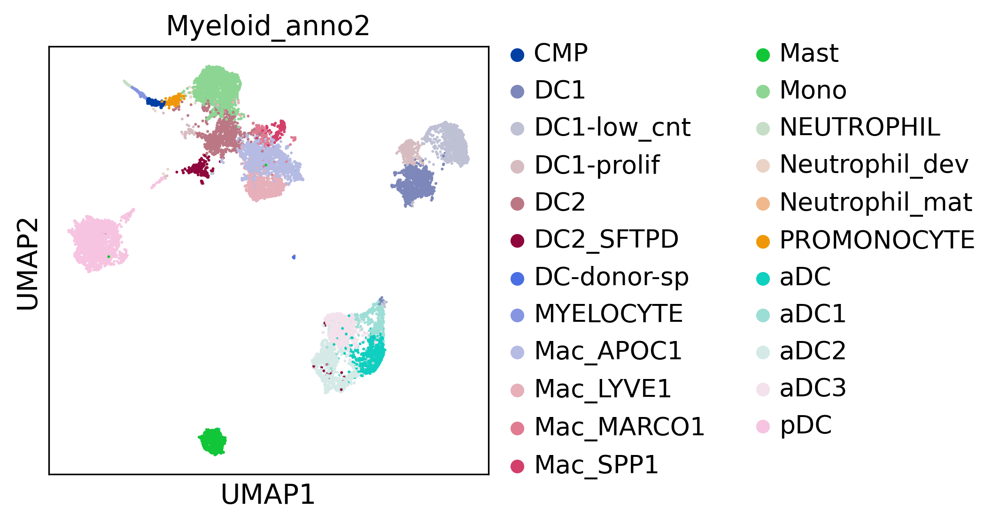

In [92]:
sc.pl.umap(adata, color = 'Myeloid_anno2')

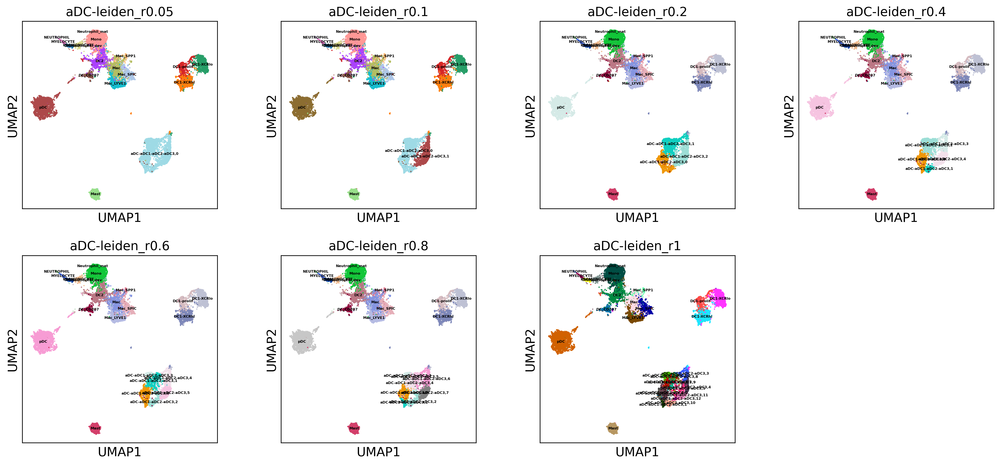

In [137]:
run_leiden(adata, resolutions = [0.05, 0.1, 0.2, 0.4, 0.6, 0.8, 1], restrict_to=['Myeloid_anno', ['aDC','aDC1', 'aDC2', 'aDC3']], key_name = 'aDC')

In [140]:
adata.obs['aDC-leiden_r0.4'] = adata.obs['aDC-leiden_r0.4'].cat.rename_categories([i.replace('aDC-aDC1-aDC2-aDC3', 'aDC') for i in adata.obs['aDC-leiden_r0.4'].cat.categories]).copy()
adata.obs['aDC-leiden_r0.6'] = adata.obs['aDC-leiden_r0.6'].cat.rename_categories([i.replace('aDC-aDC1-aDC2-aDC3', 'aDC') for i in adata.obs['aDC-leiden_r0.6'].cat.categories]).copy()

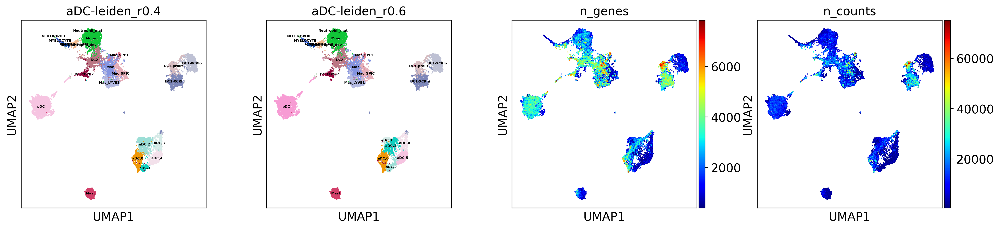

In [141]:
sc.pl.umap(adata, color = ['aDC-leiden_r0.4', 'aDC-leiden_r0.6', 'n_genes', 'n_counts'], cmap = 'jet', legend_loc = "on data", legend_fontsize = 4)

In [126]:
adc_mrkrs = scvi_markers(vae, cluster = 'aDC-leiden_r0.4', adata = adata)

DE...: 100%|██████████████████████████████████████████████████████████████████████████| 23/23 [02:48<00:00,  7.34s/it]


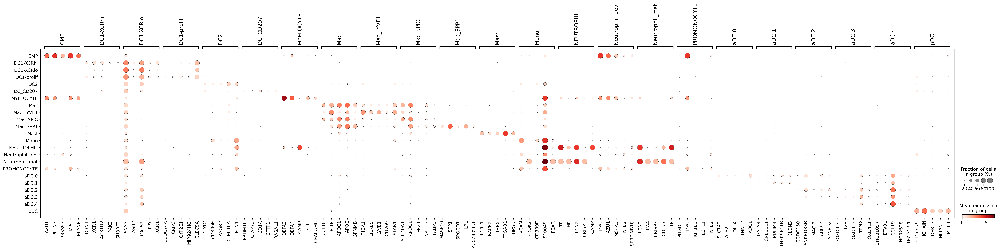

In [127]:
sc.tl.dendrogram(adata, groupby = 'aDC-leiden_r0.4', use_rep = 'X_scVI')
sc.pl.dotplot(adata, groupby = 'aDC-leiden_r0.4', var_names = adc_mrkrs['markers'])

In [142]:
adata.obs['aDC-leiden_r0.4'].value_counts()

aDC-leiden_r0.4
pDC               2235
Mono              1756
Mac               1056
DC1-XCRlo         1047
aDC,2             1020
DC1-XCRhi          958
DC2                862
aDC,4              811
Mac_LYVE1          802
aDC,0              704
Mast               660
Mac_SPIC           632
DC1-prolif         564
aDC,3              434
DC_CD207           297
aDC,1              222
PROMONOCYTE        162
CMP                160
Mac_SPP1           144
MYELOCYTE           85
NEUTROPHIL          69
Neutrophil_dev      25
Neutrophil_mat       1
Name: count, dtype: int64

In [164]:
adata.obs['Myeloid_anno3'] = adata.obs.apply(lambda x: 'aDC1' if x['aDC-leiden_r0.4'] == 'aDC,3' else
                                             'aDC2' if x['aDC-leiden_r0.4'] in ['aDC,0', 'aDC,3'] else
                                             'aDC3' if x['aDC-leiden_r0.4'] in ['aDC,2', 'aDC,4'] else
                                             x['Myeloid_anno2'], axis = 1)

In [175]:
adata.obs['Myeloid_anno3']

TA13072046-ATGTGTGTCTCTAAGG    DC1-prolif
TA13072046-GGGTTGCGTGATGTCT     DC2_SFTPD
TA13072046-TTGTAGGGTACTCTCC     MYELOCYTE
TA13072046-TTAGTTCTCTGTCTAT     Mac_SPIC1
TA13072046-CTGTTTAAGTGACTCT          Mast
                                  ...    
TEC_96-TTTGGAGTCAGGACGA              aDC3
TEC_96-ATTTCACCATCCTAAG              aDC3
TEC_96-GTAATCGGTACCGGAA              aDC3
TEC_96-GGTAACTCACATTACG              aDC3
TEC_96-ACGGAAGCAAAGCTCT              Mono
Name: Myeloid_anno3, Length: 14706, dtype: category
Categories (22, object): ['CMP', 'DC1', 'DC1-prolif', 'DC2', ..., 'aDC1', 'aDC2', 'aDC3', 'pDC']

... storing 'Myeloid_anno3' as categorical


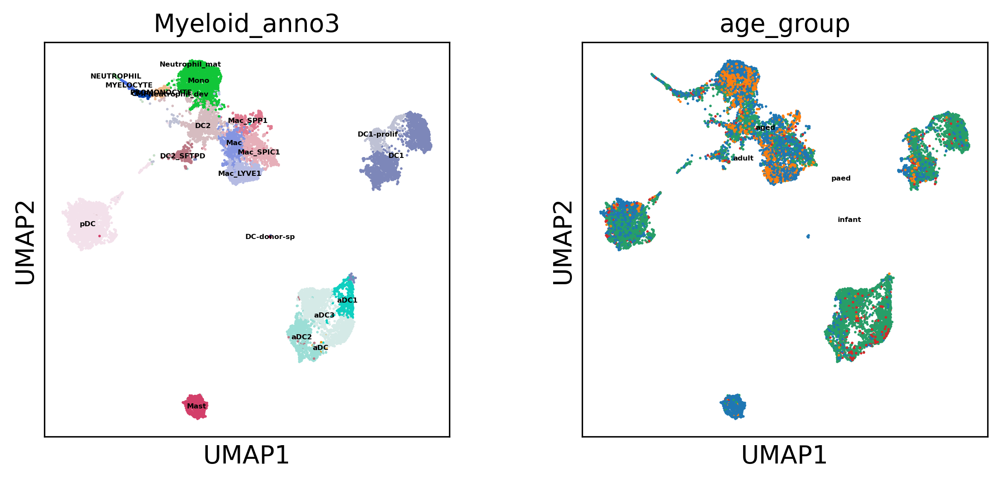

In [165]:
sc.pl.umap(adata, color = ['Myeloid_anno3', 'age_group'], ncols = 3, 
           legend_loc = 'on data', legend_fontsize = 4)

In [169]:
annotations = adata.obs[['Myeloid_anno3']].copy()

In [171]:
annotations.rename(columns = {'Myeloid_anno3':'Myeloid_anno'}, inplace = True)

In [173]:
annotations.to_csv(f'{data_path}/objects/thyAgeing_Myeloid_v3_2layers_300epochs_2025-02-27_anno1.csv')

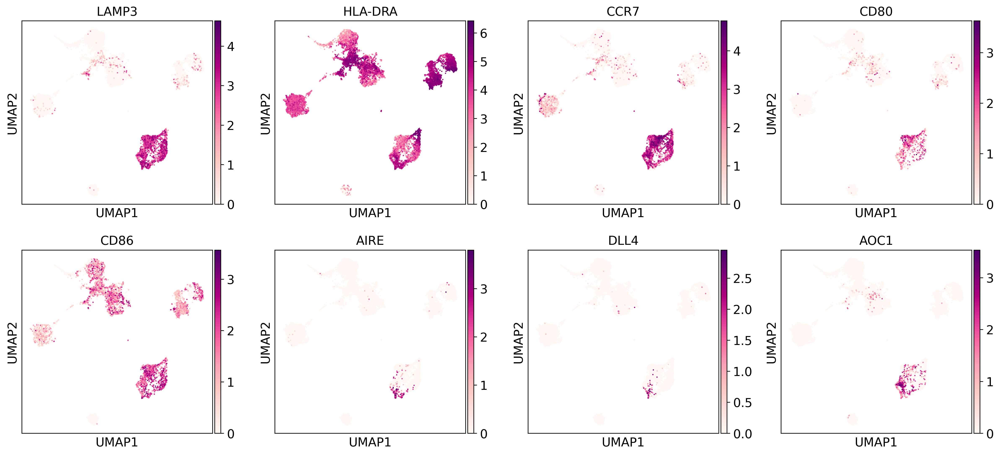

In [131]:
sc.pl.umap(adata, color = ['LAMP3', 'HLA-DRA','CCR7', 'CD80','CD86', 'AIRE', 'DLL4', 'AOC1'])

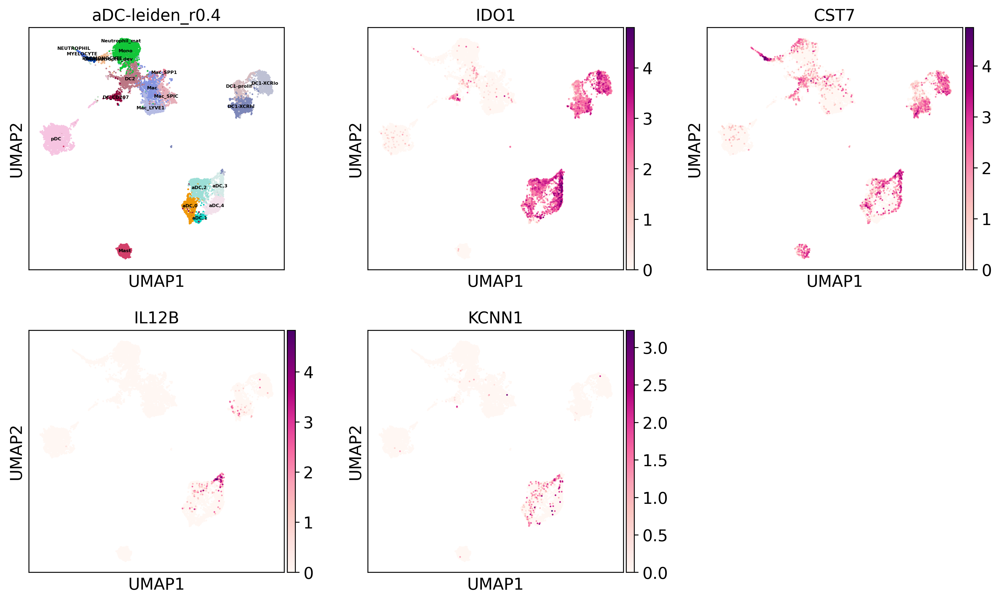

In [145]:
sc.pl.umap(adata, color = ['aDC-leiden_r0.4', 'IDO1', 'CST7', 'IL12B', 'KCNN1'], ncols = 3, 
           legend_loc = 'on data', legend_fontsize = 4)

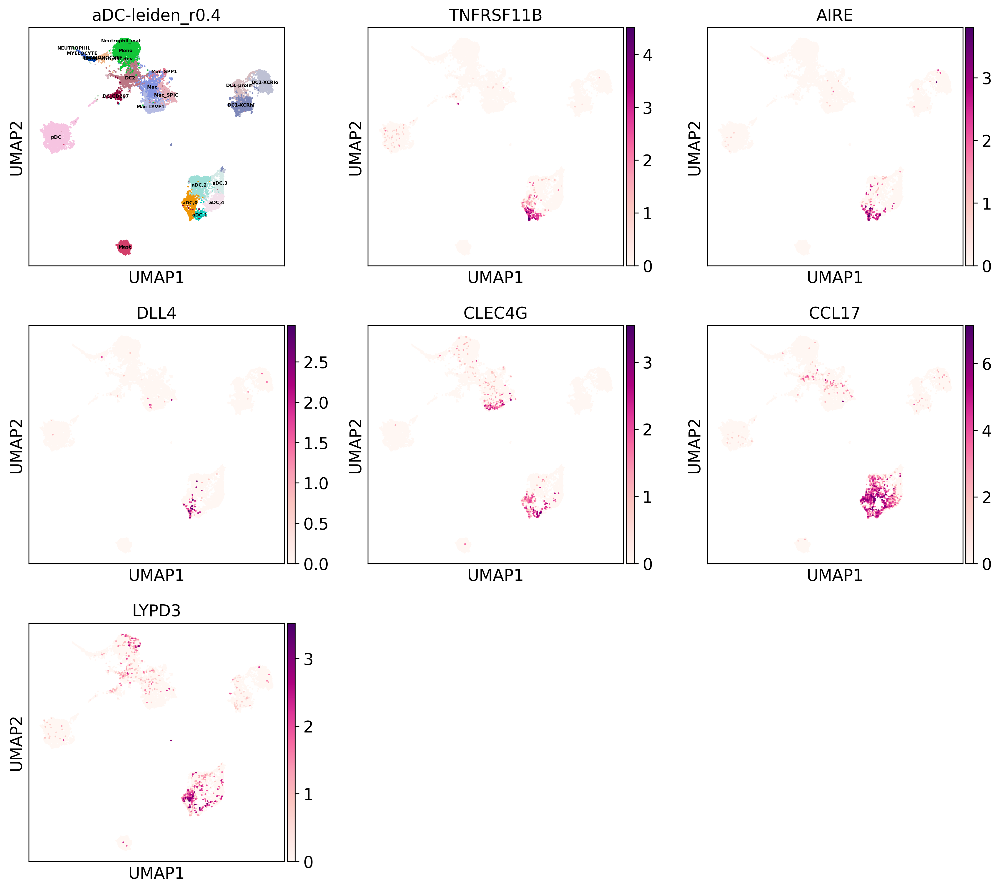

In [147]:
sc.pl.umap(adata, color = ['aDC-leiden_r0.4', 'TNFRSF11B', 'AIRE', 'DLL4', 'CLEC4G', 'CCL17','LYPD3'],  ncols = 3, 
           legend_loc = 'on data', legend_fontsize = 4)

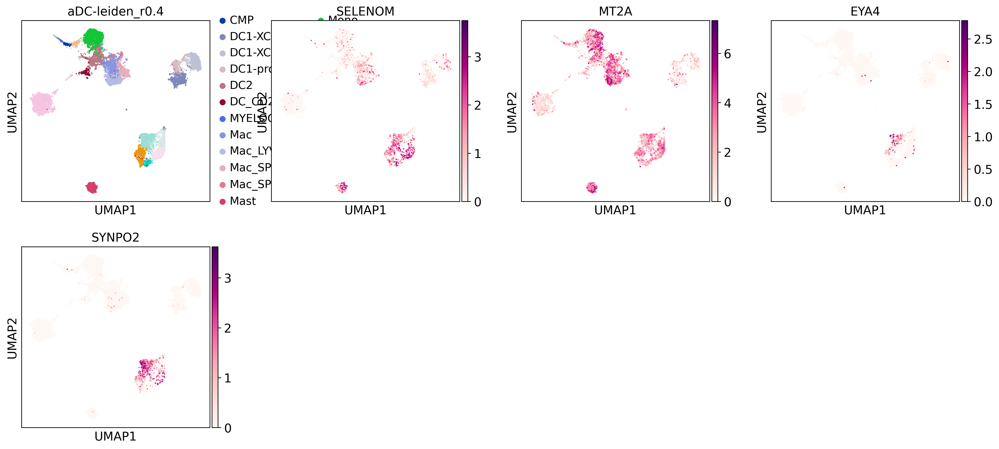

In [148]:
sc.pl.umap(adata, color = ['aDC-leiden_r0.4', 'SELENOM', 'MT2A', 'EYA4', 'SYNPO2'])

In [33]:
dblt_mrkrs = ['CD3G', 'CD8A', 'CD8B', 'CD40LG', 'KRT14', 'PDGFRA', 'RGS5', 'CD19', 'PDGFRA', 'CD34',
             'TAGLN', 'LUM', 'VCAM1', 'COL4A1']

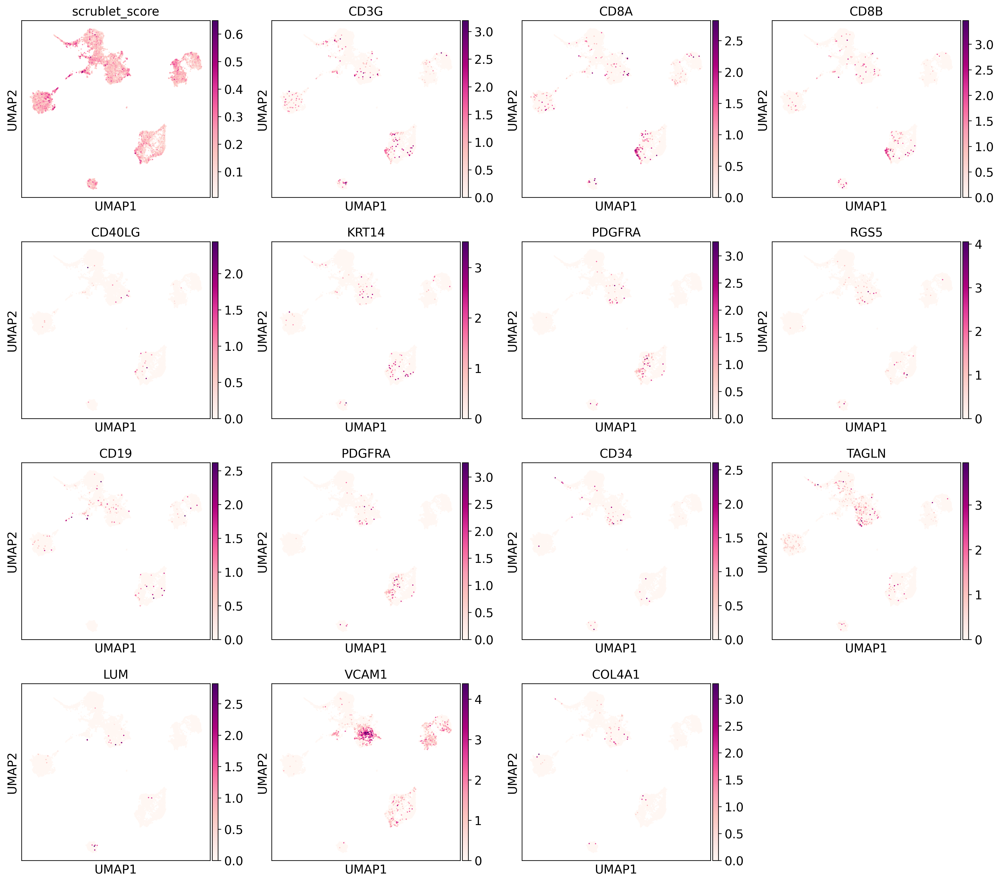

In [35]:
sc.pl.umap(adata, color = ['scrublet_score']+dblt_mrkrs)

In [25]:
sc.pl.umap(adata, color = myeloid_mrkrs)

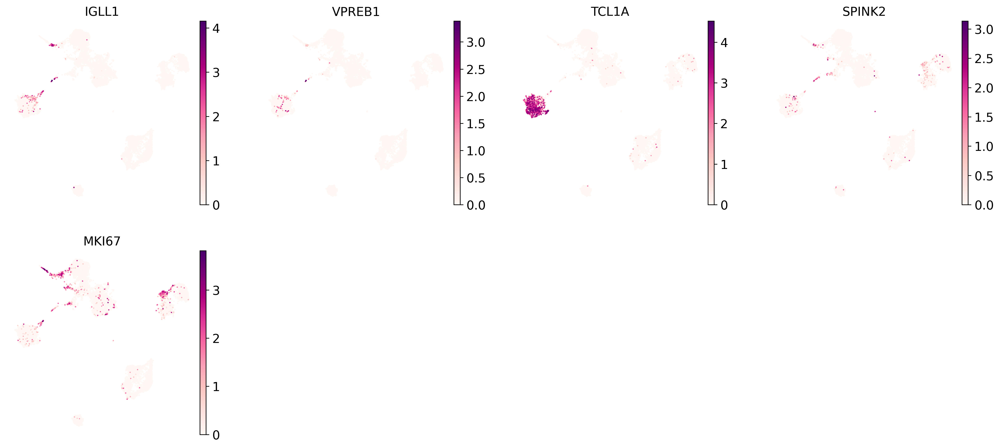

In [125]:
sc.pl.umap(adata, color = ['IGLL1', 'VPREB1', 'TCL1A', 'SPINK2', 'MKI67'], legend_loc = 'on data', legend_fontsize = 5, frameon = False)

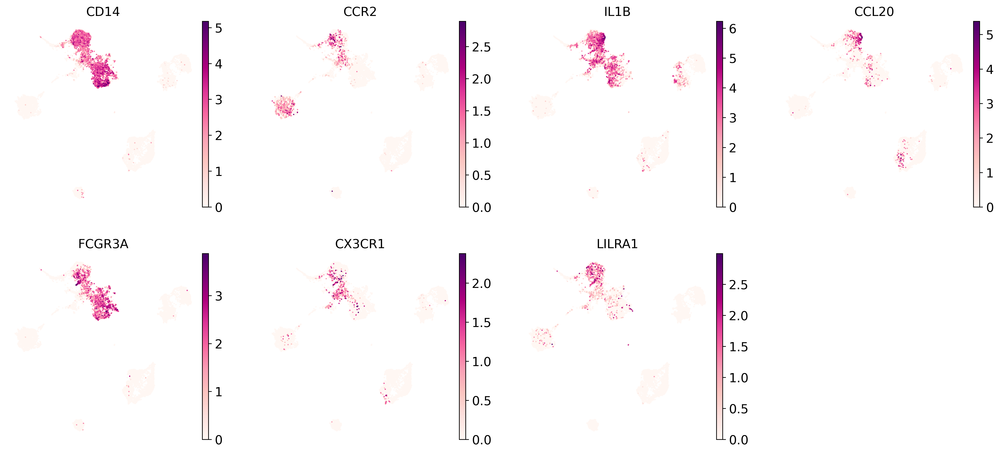

In [120]:
sc.pl.umap(adata, color = ['CD14', 'CCR2', 'IL1B', 'CCL20', 'FCGR3A', 'CX3CR1', 'LILRA1'], legend_loc = 'on data', legend_fontsize = 5, frameon = False)

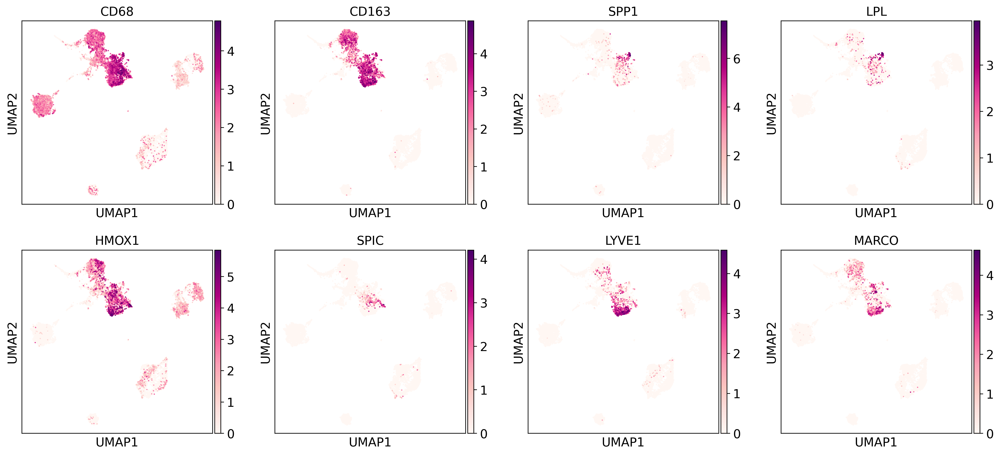

In [121]:
sc.pl.umap(adata, color = ['CD68', 'CD163', 'SPP1', 'LPL', 'HMOX1', 'SPIC', 'LYVE1', 'MARCO'])

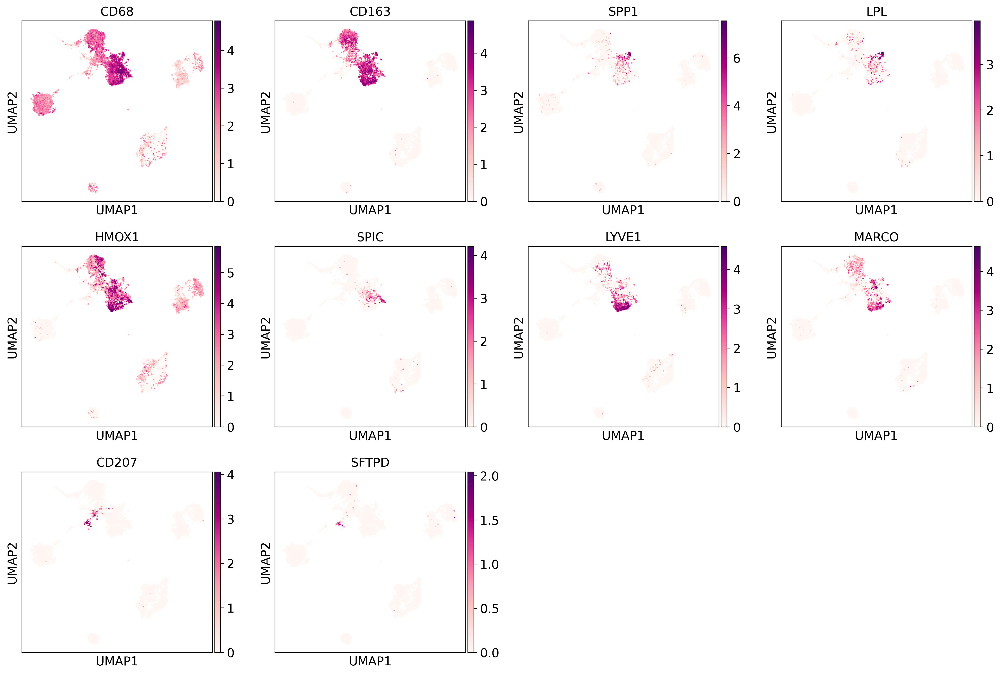

In [122]:
sc.pl.umap(adata, color = ['CD68', 'CD163', 'SPP1', 'LPL', 'HMOX1', 'SPIC', 'LYVE1', 'MARCO', 'CD207', 'SFTPD'])

### Load adata and complete the annotation

In [53]:
f'{data_path}/objects/thyAgeing_scvi_v2_2024-11-05_myeloidSplit_v3_2layers_300epochs_2025-02-04.zarr'

'/nfs/team205/vk8/projects/thymus_ageing_atlas/Myeloid_compartment/data/objects/thyAgeing_scvi_v2_2024-11-05_myeloidSplit_v3_2layers_300epochs_2025-02-04.zarr'

In [9]:
adata = ad.read_h5ad(f'{data_path}/objects/thyAgeing_scvi_v2_2024-11-05_myeloidSplit_v3_2layers_300epochs_2025-02-04.zarr')

In [10]:
annotations = pd.read_csv(f'{data_path}/objects/thyAgeing_Myeloid_v3_2layers_300epochs_2025-02-27_anno1.csv', index_col = 0)

In [11]:
from utils import update_obs

In [12]:
adata.obs['Myeloid_anno'] = annotations.reindex(adata.obs_names)['Myeloid_anno'].copy()

In [19]:
adata.obs['Myeloid_anno2'] = adata.obs['Myeloid_anno'].apply(lambda x: 'Mono' if x in ['Neutrophil_dev', 'Neutrophil_mat'] else
                                                            'Promonocyte' if x == 'PROMONOCYTE' else
                                                            'Myelocyte' if x == 'MYELOCYTE' else
                                                            'Neutrophil' if x == 'NEUTROPHIL' else 
                                                             'aDC2' if x == 'aDC' else x)

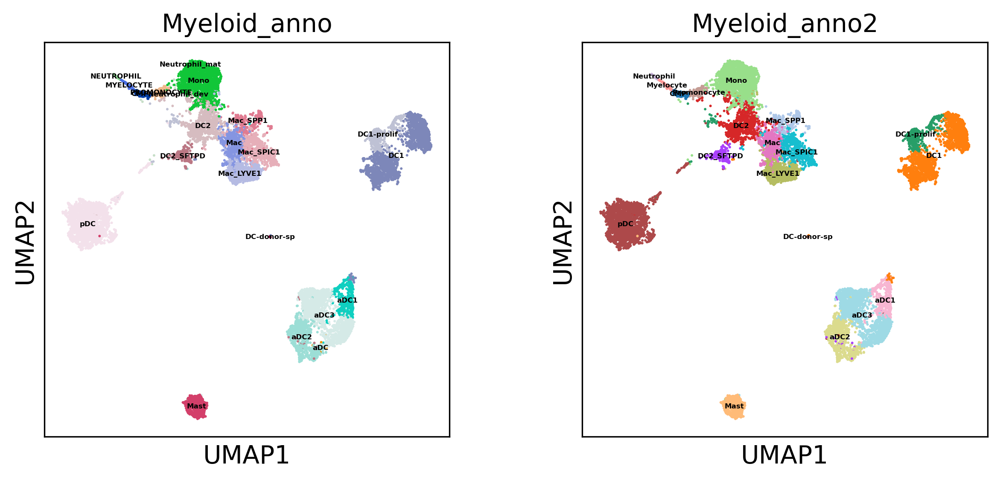

In [20]:
sc.pl.umap(adata, color = ['Myeloid_anno', 'Myeloid_anno2'], ncols = 3, 
           legend_loc = 'on data', legend_fontsize = 4)

In [21]:
from utils_vk8 import run_leiden

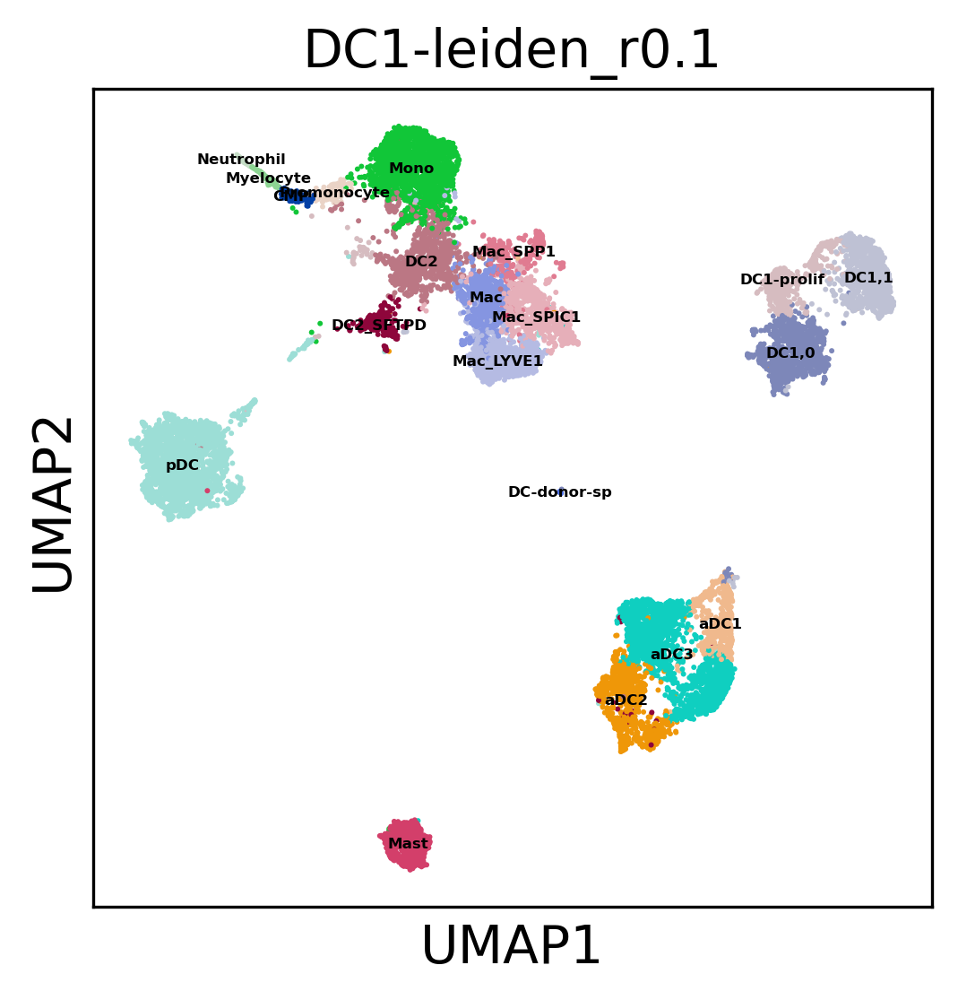

In [38]:
run_leiden(adata, resolutions = [0.1], key_name='DC1', restrict_to=['Myeloid_anno2', ['DC1']])

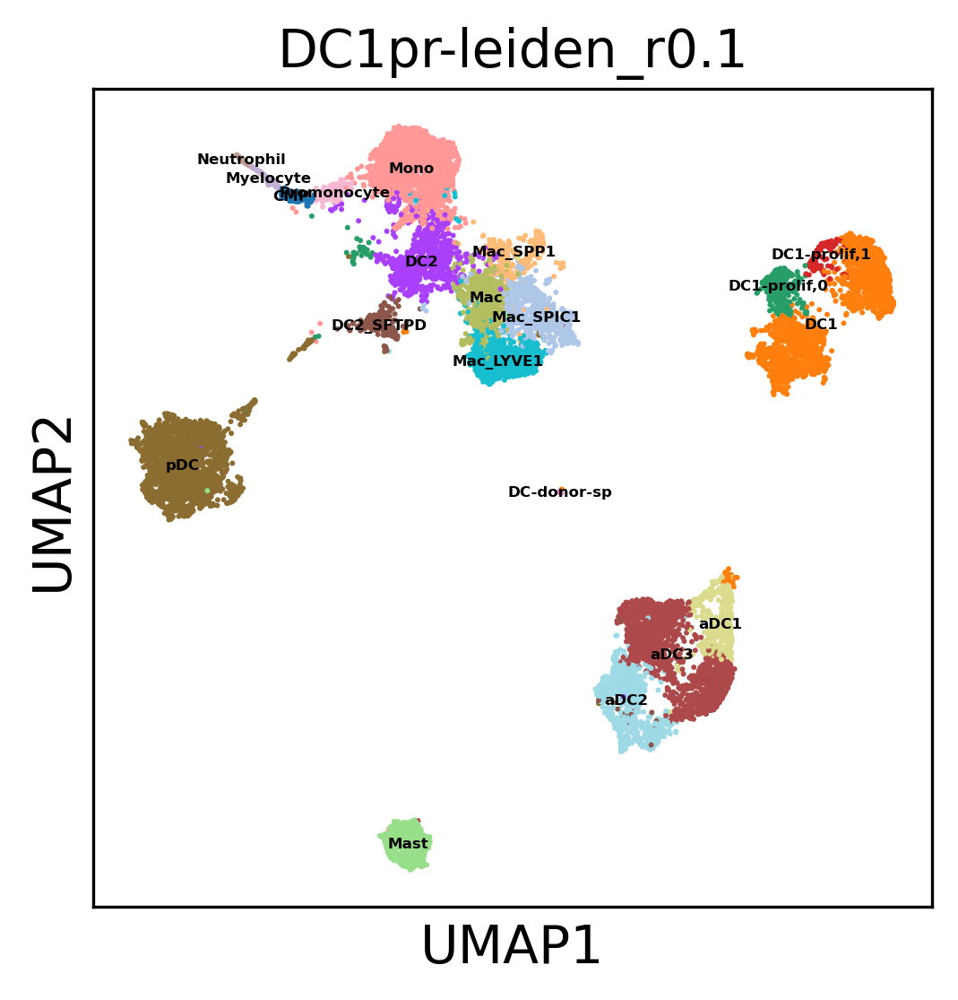

In [39]:
run_leiden(adata, resolutions = [0.1], key_name='DC1pr', restrict_to=['Myeloid_anno2', ['DC1-prolif']])

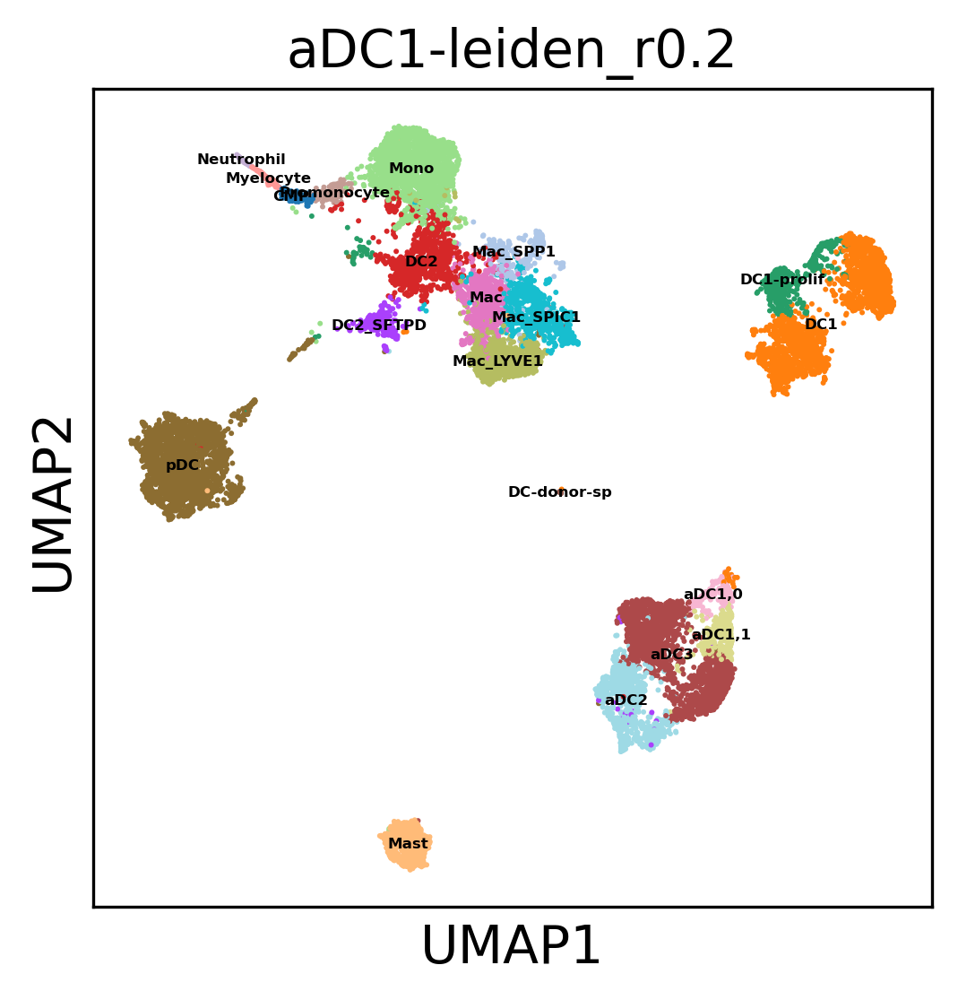

In [35]:
run_leiden(adata, resolutions = [0.2], key_name='aDC1', restrict_to=['Myeloid_anno2', ['aDC1']])

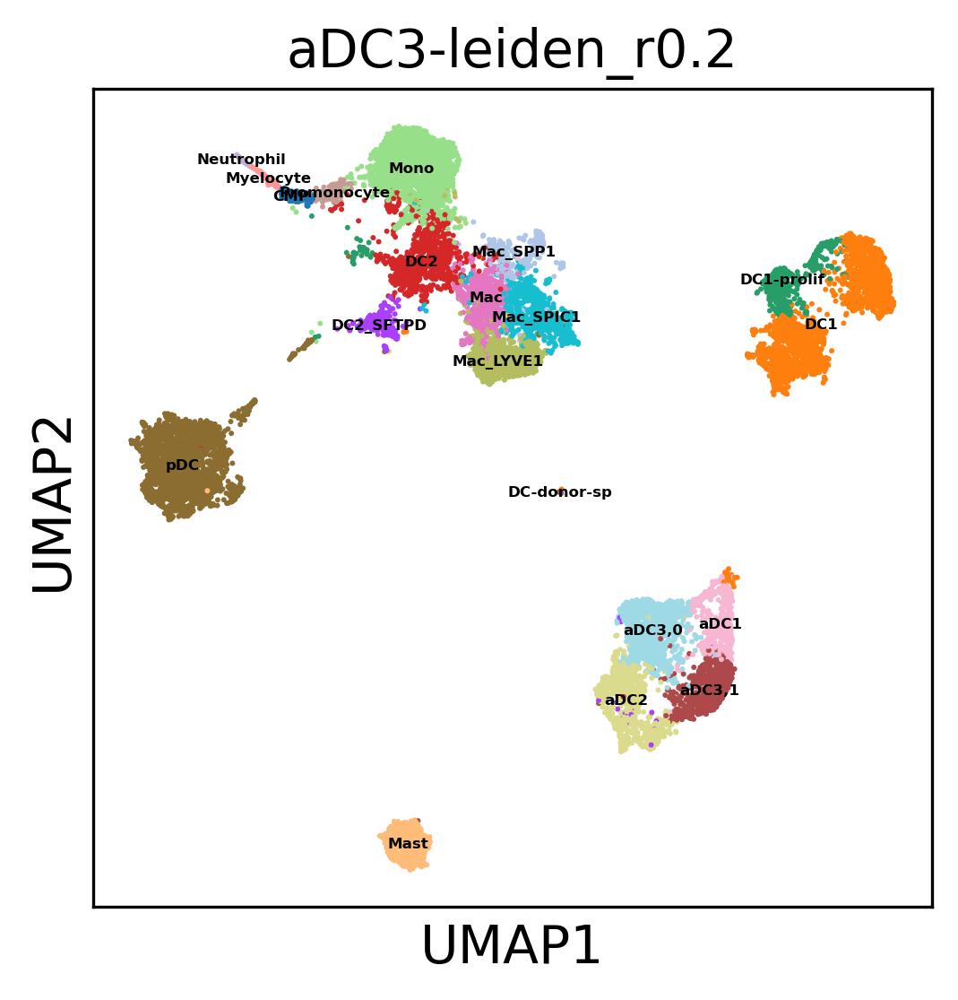

In [36]:
run_leiden(adata, resolutions = [0.2], key_name='aDC3', restrict_to=['Myeloid_anno2', ['aDC3']])

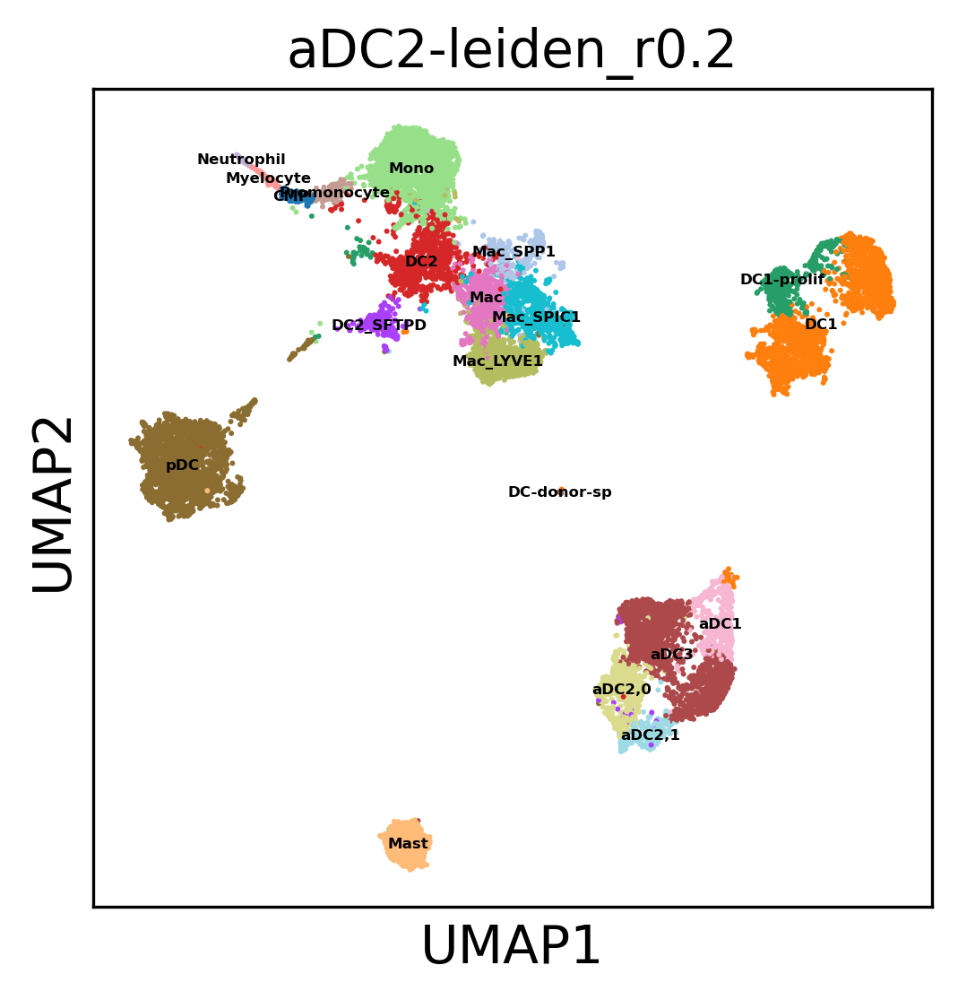

In [37]:
run_leiden(adata, resolutions = [0.2], key_name='aDC2', restrict_to=['Myeloid_anno2', ['aDC2']])

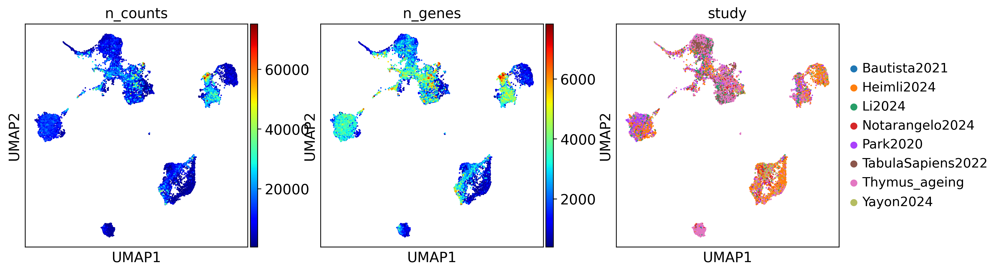

In [42]:
sc.pl.umap(adata, color = ['n_counts', 'n_genes', 'study'],
           cmap = 'jet', ncols = 3)

In [57]:
adata.obs['Myeloid_anno3'] = adata.obs.apply(lambda x: 'DC1-locnt' if x['DC1-leiden_r0.1'] == 'DC1,1' else
                                             'DC1-prolif-locnt' if x['DC1pr-leiden_r0.1'] == 'DC1-prolif,1' else
                                             'aDC1-locnt' if x['aDC1-leiden_r0.2'] == 'aDC1,1' else
                                             'aDC3-locnt' if x['aDC3-leiden_r0.2'] == 'aDC3,1' else
                                             'aDC2-locnt' if x['aDC2-leiden_r0.2'] == 'aDC2,1' else 
                                             'Mac_SPIC' if x['Myeloid_anno2'] == 'Mac_SPIC1' else
                                            x['Myeloid_anno2'], axis = 1)

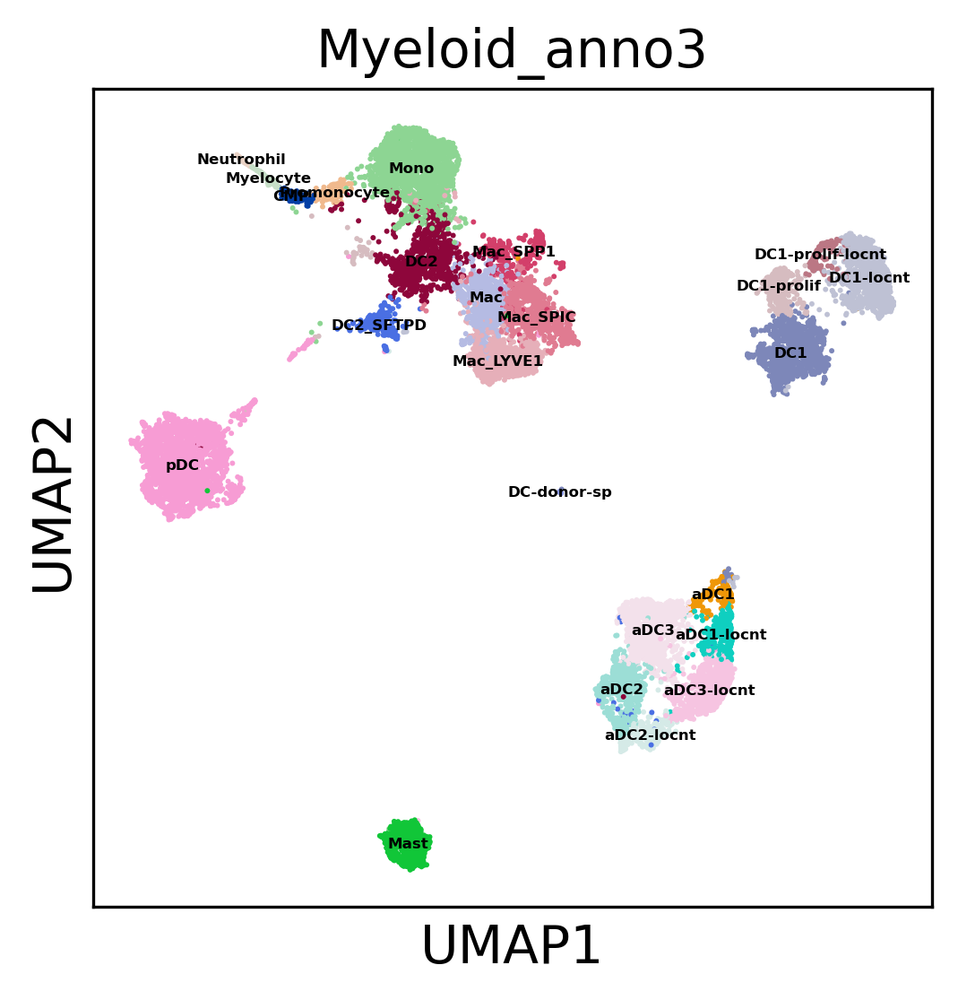

In [58]:
sc.pl.umap(adata, color = ['Myeloid_anno3'], legend_loc = 'on data', legend_fontsize = 4)

In [55]:
adata.obs['Myeloid_anno3'].cat.reorder_categories (['CMP', 'Myelocyte', 'Neutrophil', 
                                                    'Promonocyte', 'Mono', 'Mac', 'Mac_LYVE1', 'Mac_SPIC', 'Mac_SPP1',
                                                   'DC1', 'DC1-locnt', 'DC1-prolif', 'DC1-prolif-locnt',
                                                   'DC2', 'DC2_SFTPD', 'aDC1',
       'aDC1-locnt', 'aDC2', 'aDC2-locnt', 'aDC3', 'aDC3-locnt', 'pDC', 'Mast'])

Index(['CMP', 'DC1', 'DC1-locnt', 'DC1-prolif', 'DC1-prolif-locnt', 'DC2',
       'DC2_SFTPD', 'DC-donor-sp', 'Mac', 'Mac_LYVE1', 'Mac_SPIC1', 'Mac_SPP1',
       'Mast', 'Mono', 'Myelocyte', 'Neutrophil', 'Promonocyte', 'aDC1',
       'aDC1-locnt', 'aDC2', 'aDC2-locnt', 'aDC3', 'aDC3-locnt', 'pDC'],
      dtype='object')

In [56]:
myeloid_mrkrs_dict

{'Early progenitor': ['CD34', 'SPINK2'],
 'Myeloid progenitor': ['PRSS57', 'PRTN3', 'AZU1'],
 'Neutrophil lineage': ['ELANE', 'DEFA4', 'LCN2', 'ORM1'],
 'Monocyte lineage': ['CD52',
  'S100A8',
  'MS4A6A',
  'CD14',
  'CXCR4',
  'CCR2',
  'IL1B'],
 'RBC': ['GYPA', 'GYPB', 'HBA1', 'HBA2'],
 'panMacrophage': ['CD68', 'CD163'],
 'LYVE1 Macrophage': ['LYVE1', 'EGFL7', 'LILRB5'],
 'SPIC Macrophage': ['SPIC', 'TIMD4'],
 'APOC2 Macrophage': ['APOC2', 'MMP9', 'GPNMB'],
 'cDC1': ['CLEC9A', 'XCR1'],
 'cDC2': ['CLEC10A', 'CD1C'],
 'aDC': ['LAMP3', 'CCR7', 'CD80', 'HLA-DRA', 'CD86'],
 'aDC1': ['IDO1', 'CST7', 'IL12B', 'KCNN1'],
 'aDC2': ['TNFRSF11B', 'CCL17', 'LYPD3', 'CLEC4G'],
 'aDC3': ['SELENOM', 'MT2A', 'EYA4', 'SYNPO2'],
 'AIRE DCs': ['TNFRSF11B', 'AIRE'],
 'pDC': ['LILRA4', 'CLEC4C'],
 'Prolif': ['MKI67', 'TOP2A']}

In [59]:
annotations = adata.obs[['Myeloid_anno3']].copy()

In [60]:
annotations.rename(columns = {'Myeloid_anno3':'Myeloid_anno'}, inplace = True)

In [61]:
f'{data_path}/objects/thyAgeing_Myeloid_v3_2layers_300epochs_2025-03-03_anno3.csv'

'/nfs/team205/vk8/projects/thymus_ageing_atlas/Myeloid_compartment/data/objects/thyAgeing_Myeloid_v3_2layers_300epochs_2025-03-03_anno3.csv'

In [62]:
annotations.to_csv(f'{data_path}/objects/thyAgeing_Myeloid_v3_2layers_300epochs_2025-03-03_anno3.csv')

In [ ]:
pd.read_csv(f'{data_path}/objects/thyAgeing_Myeloid_v3_2layers_300epochs_2025-02-27_anno1.csv', index_col = 0)